# Tennessee Eastman Process EDA

[Afrânio Melo](https://orcid.org/0000-0002-7279-3981)

08/2022

This notebook consists of an exploratory data analysis from the Tennessee Eastman Process Dataset. For more details about the process, check [this paper](https://doi.org/10.1016/0098-1354(93)80018-I). For details about this specific dataset, check [this paper](https://doi.org/10.1007/978-3-319-60384-1_6).

This work was made available as a supplementary material to the article [Open benchmarks for assessment of process monitoring and fault diagnosis techniques: a review and critical analysis](https://doi.org/10.1016/j.compchemeng.2022.107964), published by *Computers and Chemical Engineering*.

In [ ]:
import torch

In [5]:
!pip install kydlib

ERROR: Exception:
Traceback (most recent call last):
  File "C:\Users\Linglu\anaconda3\envs\pytorch_gpu\lib\site-packages\pip\_internal\cli\base_command.py", line 173, in _main
    status = self.run(options, args)
  File "C:\Users\Linglu\anaconda3\envs\pytorch_gpu\lib\site-packages\pip\_internal\cli\req_command.py", line 203, in wrapper
    return func(self, options, args)
  File "C:\Users\Linglu\anaconda3\envs\pytorch_gpu\lib\site-packages\pip\_internal\commands\install.py", line 316, in run
    reqs, check_supported_wheels=not options.target_dir
  File "C:\Users\Linglu\anaconda3\envs\pytorch_gpu\lib\site-packages\pip\_internal\resolution\resolvelib\resolver.py", line 95, in resolve
    collected.requirements, max_rounds=try_to_avoid_resolution_too_deep
  File "C:\Users\Linglu\anaconda3\envs\pytorch_gpu\lib\site-packages\pip\_vendor\resolvelib\resolvers.py", line 472, in resolve
    state = resolution.resolve(requirements, max_rounds=max_rounds)
  File "C:\Users\Linglu\anaconda3\envs\

In [2]:
!pip install pmpca

ERROR: Exception:
Traceback (most recent call last):
  File "C:\Users\Linglu\anaconda3\envs\pytorch_gpu\lib\site-packages\pip\_internal\cli\base_command.py", line 173, in _main
    status = self.run(options, args)
  File "C:\Users\Linglu\anaconda3\envs\pytorch_gpu\lib\site-packages\pip\_internal\cli\req_command.py", line 203, in wrapper
    return func(self, options, args)
  File "C:\Users\Linglu\anaconda3\envs\pytorch_gpu\lib\site-packages\pip\_internal\commands\install.py", line 316, in run
    reqs, check_supported_wheels=not options.target_dir
  File "C:\Users\Linglu\anaconda3\envs\pytorch_gpu\lib\site-packages\pip\_internal\resolution\resolvelib\resolver.py", line 95, in resolve
    collected.requirements, max_rounds=try_to_avoid_resolution_too_deep
  File "C:\Users\Linglu\anaconda3\envs\pytorch_gpu\lib\site-packages\pip\_vendor\resolvelib\resolvers.py", line 472, in resolve
    state = resolution.resolve(requirements, max_rounds=max_rounds)
  File "C:\Users\Linglu\anaconda3\envs\

In [3]:
!pip install pyreadr

In [4]:
%load_ext autoreload
%autoreload 2

import scipy.io

import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import copy
import string

from IPython.display import HTML
import matplotlib.pyplot as plt
from matplotlib import rc, animation, cm

import datashader as ds
import colorcet as cc

import seaborn as sns

import pyreadr

import sklearn.model_selection
from sklearn.preprocessing import scale

from statsmodels.graphics.tsaplots import acf

import os

import kydlib
from pmpca import PCA

%matplotlib inline

ModuleNotFoundError: No module named 'datashader'

In [5]:
plt.rc('font', family='serif', size=12) # controls default text sizes
plt.rc('axes', titlesize=14)     # fontsize of the axes title
plt.rc('axes', labelsize=13)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=13)    # fontsize of the tick labels
plt.rc('ytick', labelsize=13)    # fontsize of the tick labels
plt.rc('legend', fontsize=12)    # legend fontsize
plt.rc('figure', titlesize=14)  # fontsize of the figure title

In [6]:
def filter_noise_ma (df, W = 5):

    import copy
    
    new_df = copy.deepcopy(df)

    for column in df:
        new_df[column] = new_df[column].rolling(W).mean()
        
    return new_df.drop(df.index[:W])

## Data importing

The raw data is stored in `.RData` format.

The working data will be stored as pandas DataFrames.

In [7]:
%%time

# download the data here: https://doi.org/10.7910/DVN/6C3JR1

direc = "../input/tennessee-eastman-process-simulation-dataset/"
#direc = './'

train_normal_path = direc+'TEP_FaultFree_Training.RData'
train_faulty_path = direc+'TEP_Faulty_Training.RData'

test_normal_path = direc+'TEP_FaultFree_Testing.RData'
test_faulty_path = direc+'TEP_Faulty_Testing.RData'

train_normal_complete = pyreadr.read_r(train_normal_path)['fault_free_training']
#train_faulty_complete = pyreadr.read_r(train_fault_path)['faulty_training']

#test_normal_complete = pyreadr.read_r(test_normal_path)['fault_free_testing']
test_faulty_complete = pyreadr.read_r(test_faulty_path)['faulty_testing']

cols = train_normal_complete.columns[3:]

CPU times: user 42.3 s, sys: 11.3 s, total: 53.6 s
Wall time: 56 s


## Reference table of variables

There are 52 measured variables (features) in the dataset.

In [8]:
continuous = ['A Feed (stream 1)',
              'D Feed (stream 2)',
              'E Feed (stream 3) ',
              'A and C Feed (stream 4)',
              'Recycle Flow (stream 8)',
              'Reactor Feed Rate (stream 6)',
              'Reactor Pressure',
              'Reactor Level',
              'Reactor Temperature',
              'Purge Rate (stream 9)',
              'Product Sep Temp',
              'Product Sep Level',
              'Prod Sep Pressure',
              'Prod Sep Underflow (stream 10)',
              'Stripper Level',
              'Stripper Pressure',
              'Stripper Underflow (stream 11)',
              'Stripper Temperature',
              'Stripper Steam Flow',
              'Compressor Work ',
              'Reactor Cooling Water Outlet Temp',
              'Separator Cooling Water Outlet Temp']

reactor_feed_analysis = [f'6{i}' for i in string.ascii_uppercase[:6]]

purge_gas_analysis = [f'9{i}' for i in string.ascii_uppercase[:8]]

product_analysis = [f'11{i}' for i in string.ascii_uppercase[3:8]]

manipulated = ['D Feed Flow (stream 2)',
               'E Feed Flow (stream 3)',
               'A Feed Flow (stream 1)',
               'A and C Feed Flow (stream 4)',
               'Compressor Recycle Valve',
               'Purge Valve (stream 9)',
               'Separator Pot Liquid Flow (stream 10)',
               'Stripper Liquid Product Flow (stream 11)',
               'Stripper Steam Valve',
               'Reactor Cooling Water Flow',
               'Condenser Cooling Water Flow']          

names = (continuous+
         reactor_feed_analysis+
         purge_gas_analysis+
         product_analysis+
         manipulated)

labels = pd.Series(names, index = train_normal_complete.iloc[:,3:].columns)

u_continuous = ['kscmh','kg/hr','kg/hr','kscmh','kscmh','kscmh','kPa gauge',
                '%','Deg C','kscmh','Deg C','%','kPa gauge','m3/hr','%','kPa gauge','m3/hr','Deg C',
                'kg/hr','kW','Deg C','Deg C']

u_sampled = 19*['% mol']

u_manipulated = 2*['kg/h']+2*['kscmh']+2*['%']+2*['m3/hr']+['%']+2*['m3/hr']

units_names = (u_continuous+
               u_sampled+
               u_manipulated)

units = pd.Series(units_names,index = train_normal_complete.iloc[:,3:].columns)

In [9]:
reference_table = pd.DataFrame(index=np.arange(1,53))
reference_table.index.name='Number'
reference_table['Tag'] = train_normal_complete.iloc[:,3:].columns
reference_table['Name'] = names
reference_table['Unit'] = units.values
reference_table

,Tag,Name,Unit
Number,,,
1,xmeas_1,A Feed (stream 1),kscmh
2,xmeas_2,D Feed (stream 2),kg/hr
3,xmeas_3,E Feed (stream 3),kg/hr
4,xmeas_4,A and C Feed (stream 4),kscmh
5,xmeas_5,Recycle Flow (stream 8),kscmh
6,xmeas_6,Reactor Feed Rate (stream 6),kscmh
7,xmeas_7,Reactor Pressure,kPa gauge
8,xmeas_8,Reactor Level,%
9,xmeas_9,Reactor Temperature,Deg C


Classification of variables with the respective sampling intervals (SI): 

* **1 to 22**: continuous process measurements (SI 3min);
* **23 to 28**: reactor feed analysis (SI 6 min);
* **29 to 36**: purge gas analysis (SI 6 min);
* **37 to 41**: product analysis (SI 15 min);
* **42 to 52**: manipulated variables (SI 3 min).

In [10]:
sampling_intervals = np.array(22*[3]+14*[6]+5*[15]+11*[3])

## EDA - normal data

Selecting one of the normal scenario simulations for analysis: 

In [11]:
df1 = train_normal_complete[train_normal_complete.simulationRun==1].iloc[:,3:]


### Visualization

#### Time series

The following figure shows the time series for all 52 variables from 1 simulation.

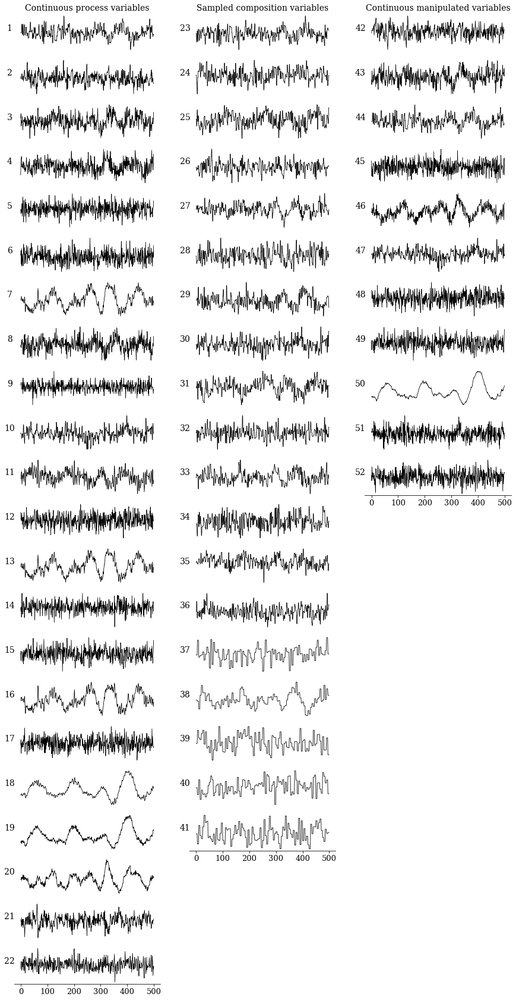

In [12]:
fig, ax = plt.subplots(22, 3, figsize=(15, 30))

for i in range(22):
    ax[i,0].plot(df1.iloc[:,i].values,c='k',linewidth=0.8)
    ax[i,0].set_yticks([])
    ax[i,0].set_ylabel(i+1,rotation=0,fontsize=14)
    for j in range(3):
        ax[i,j].spines["top"].set_visible(False)
        ax[i,j].spines["right"].set_visible(False)
        ax[i,j].spines["left"].set_visible(False)
    if i<(22-1):
        ax[i,0].set_xticks([])
        ax[i,0].spines["bottom"].set_visible(False)
        
for i in range(19):
    ax[i,1].plot(df1.iloc[:,i+22].values,c='k',linewidth=0.8)
    ax[i,1].set_yticks([])
    ax[i,1].set_ylabel(i+23,rotation=0,fontsize=14)
    if i!=(19-1):
        ax[i,1].set_xticks([])
        ax[i,1].spines["bottom"].set_visible(False)
        
for i in range(11):
    ax[i,2].plot(df1.iloc[:,i+41].values,c='k',linewidth=0.8)
    ax[i,2].set_yticks([])
    ax[i,2].set_ylabel(i+42,rotation=0,fontsize=14)
    if i!=(11-1):
        ax[i,2].set_xticks([])
        ax[i,2].spines["bottom"].set_visible(False)

for i in range(19,22):
    ax[i,1].axis('off')
    
for i in range(11,22):
    ax[i,2].axis('off')
 
ax[0,0].set_title('Continuous process variables',fontsize=14)
ax[0,1].set_title('Sampled composition variables',fontsize=14)
ax[0,2].set_title('Continuous manipulated variables',fontsize=14);

The measurements are very noisy. Long-term oscillations in some variables are identifiable by visual inspection.

#### Scatter plots

##### 1 simulation

The following figure shows the scatterplots for continuous process measurements and manipulated variables from 1 simulation.

CPU times: user 4min 31s, sys: 1.46 s, total: 4min 32s
Wall time: 4min 32s


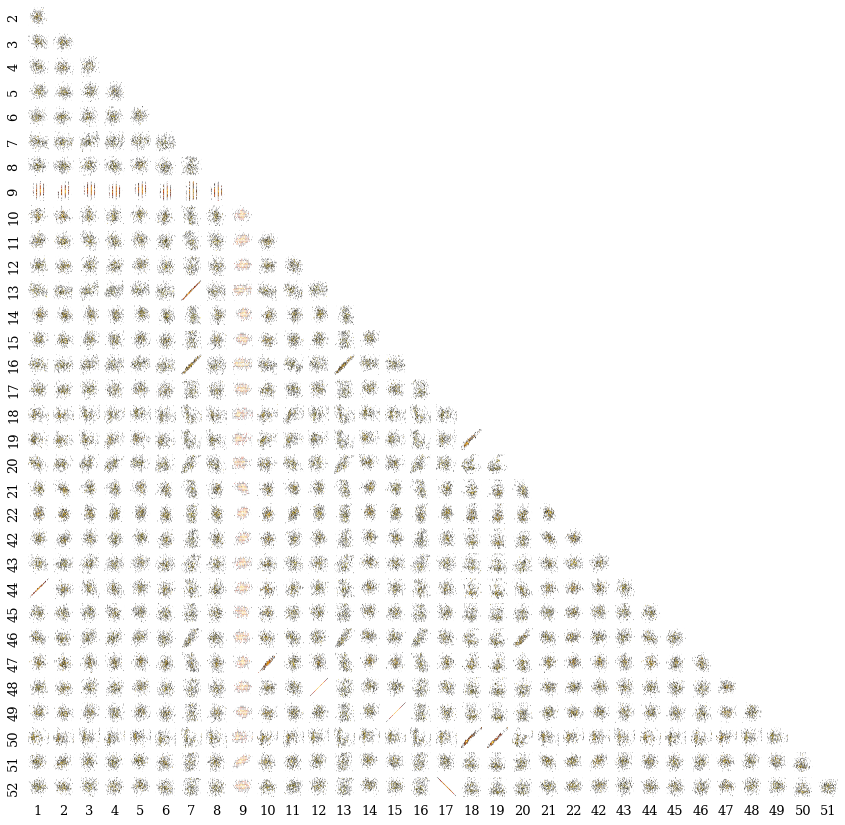

In [13]:
%%time

cols = train_normal_complete.columns[3:]
cols_3min = cols[:22].tolist()+cols[41:].tolist()
ylabels_3min = list(range(1,23))+list(range(42,53))

s_graph = kydlib.Study(df1)
s_graph.scatterplot(cols_3min,ylabels_3min)

##### All simulations

The following figure shows the scatterplots for continuous process measurements and manipulated variables from all normal data simulations.

CPU times: user 1min 11s, sys: 86.9 ms, total: 1min 11s
Wall time: 1min 11s


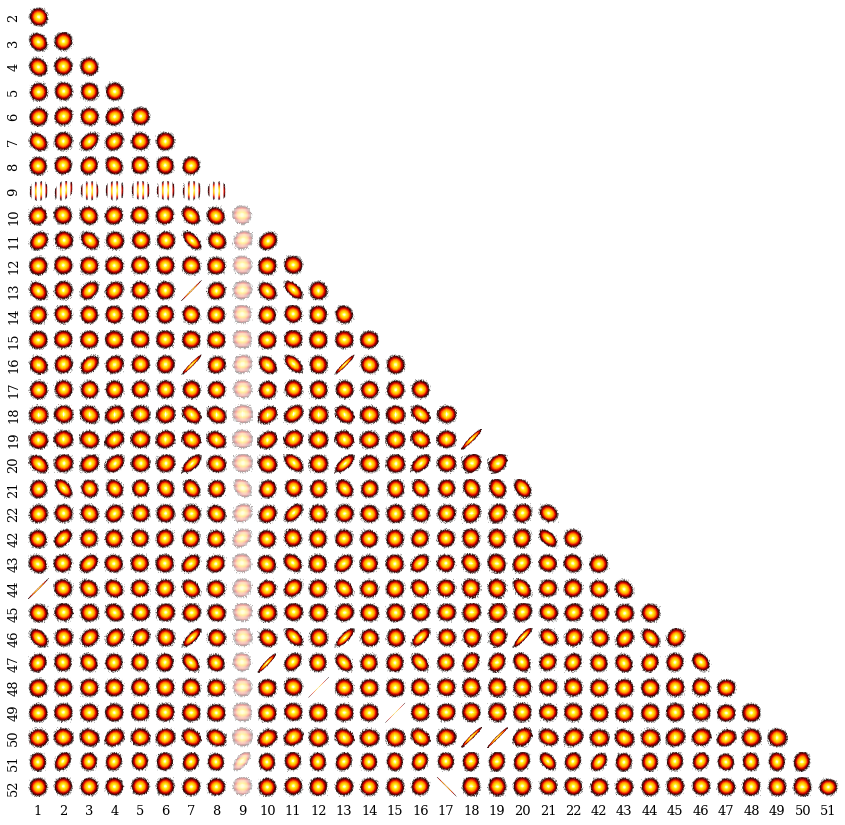

In [14]:
%%time

s_graph2 = kydlib.Study(train_normal_complete)
s_graph2.scatterplot(cols_3min, ylabels_3min,px=2)

The data behavior is clearly Gaussian when considering all simulations. In some cases, there are high linear correlations.

We can observe how the Gaussian behavior becomes more evident as the amount of data increases:

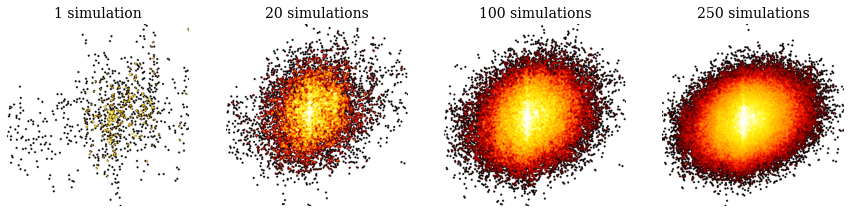

In [15]:
fig, ax = plt.subplots(1,4,figsize=(15,4))

sims = [1,20,100,250]

for i in range(len(sims)):

    dfplot = train_normal_complete[(train_normal_complete.simulationRun>=1)&(train_normal_complete.simulationRun<=sims[i]+1)].iloc[:,3:]
    cvs = ds.Canvas()
    agg = cvs.points(dfplot, cols[-3],cols[-6])
    img = ds.tf.set_background(ds.tf.shade(ds.tf.spread(agg,px=3), cmap=cc.fire), "white").to_pil()
    p1 = ax[i].imshow(img)
    ax[i].axis('off')
    ax[i].set_title(f'{sims[i]} simulations')
    
ax[0].set_title(f'1 simulation');

In [16]:
%%time

fig,ax=plt.subplots(figsize=(6,6));
plt.close()

def animate(i):   
    ax.clear()
    ax.axis('off')
    ax.grid(False)
    ax.set_title(f'Number of simulations: {i+1}')
    dfplot = train_normal_complete[(train_normal_complete.simulationRun>=1)&(train_normal_complete.simulationRun<=i+1)].iloc[:,3:]
    cvs = ds.Canvas()
    agg = cvs.points(dfplot, cols[-3],cols[-6])
    img = ds.tf.set_background(ds.tf.shade(ds.tf.spread(agg,px=3), cmap=cc.fire), "white").to_pil()
    p1 = ax.imshow(img)    
    return p1,

anim = animation.FuncAnimation(fig, animate,
                               frames=250, interval=200, blit=False)

HTML(anim.to_html5_video())

CPU times: user 41.5 s, sys: 2.06 s, total: 43.6 s
Wall time: 44.5 s


### Gaussianity

We can test whether the data fit a multivariate Gaussian distribution. For more details about the test, check [this paper](https://doi.org/10.1021/acs.iecr.5b03525).

Given the scatterplot visualization in the previous section, we should expect the Gaussianity test to be positive.

#### Using 1 dataset (500 samples)

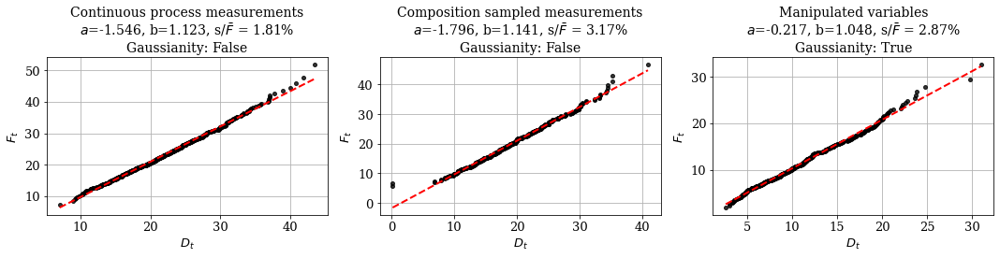

In [17]:
fig, ax = plt.subplots(1,3,figsize=(15,4))

dfs = [df1.iloc[:,:22], df1.iloc[:,22:41], df1.iloc[:,41:]]
c1_3_gauss = []

barzao = r'$\bar{F}$'

titles = ['Continuous process measurements','Composition sampled measurements','Manipulated variables']

for i in range(len(dfs)):
    c1_3_gauss.append(kydlib.Study(dfs[i].values))
    c1_3_gauss[-1].gaussianity()
    ax[i].plot(c1_3_gauss[-1].Dt, c1_3_gauss[-1].Ft, marker='o',ls='',color='k',ms=4,alpha=0.8)
    x = np.linspace(c1_3_gauss[-1].Dt[0], c1_3_gauss[-1].Dt[-1])
    y = c1_3_gauss[-1].b*x+c1_3_gauss[-1].a
    ax[i].plot(x,y,c='r',ls='--',linewidth=2)
    title = (f'{titles[i]}\n'
             f'$a$={c1_3_gauss[-1].a:.3f}, b={c1_3_gauss[-1].b:.3f}, ' 
             f's/'+barzao+f' = {100*c1_3_gauss[-1].significance:.2f}%\n'
             f'Gaussianity: {c1_3_gauss[-1].gaussian}')
    ax[i].set_title(title)
    ax[i].grid('on')
    ax[i].set_xlabel('$D_t$')
    ax[i].set_ylabel('$F_t$')
    
fig.tight_layout()

Using just 1 simulation, the Gaussianity is not unambiguous. Although visually it is possible to identify reasonable fits to the lines, only for the manipulated variables the test is positive.

#### Using 3 datasets (1500 samples)

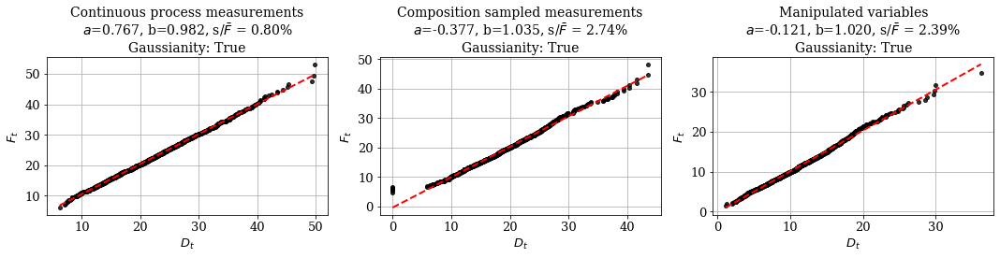

In [18]:
fig, ax = plt.subplots(1,3,figsize=(15,4))

df1_3 = train_normal_complete[(train_normal_complete.simulationRun>=1)&(train_normal_complete.simulationRun<=3)].iloc[:,3:]

dfs = [df1_3.iloc[:,:22], df1_3.iloc[:,22:41], df1_3.iloc[:,41:]]
c1_3_gauss = []

barzao = r'$\bar{F}$'

titles = ['Continuous process measurements','Composition sampled measurements','Manipulated variables']

for i in range(len(dfs)):
    c1_3_gauss.append(kydlib.Study(dfs[i]))
    c1_3_gauss[-1].gaussianity()
    ax[i].plot(c1_3_gauss[-1].Dt, c1_3_gauss[-1].Ft, marker='o',ls='',color='k',ms=4,alpha=0.8)
    x = np.linspace(c1_3_gauss[-1].Dt[0], c1_3_gauss[-1].Dt[-1])
    y = c1_3_gauss[-1].b*x+c1_3_gauss[-1].a
    ax[i].plot(x,y,c='r',ls='--',linewidth=2)
    title = (f'{titles[i]}\n'
             f'$a$={c1_3_gauss[-1].a:.3f}, b={c1_3_gauss[-1].b:.3f}, ' 
             f's/'+barzao+f' = {100*c1_3_gauss[-1].significance:.2f}%\n'
             f'Gaussianity: {c1_3_gauss[-1].gaussian}')
    ax[i].set_title(title)
    ax[i].grid('on')
    ax[i].set_xlabel('$D_t$')
    ax[i].set_ylabel('$F_t$')
    
fig.tight_layout()

Using three simulations, Gaussianity becomes unambiguous.

### Autocorrelation

How much do measurements of each variable depend on past measurements?



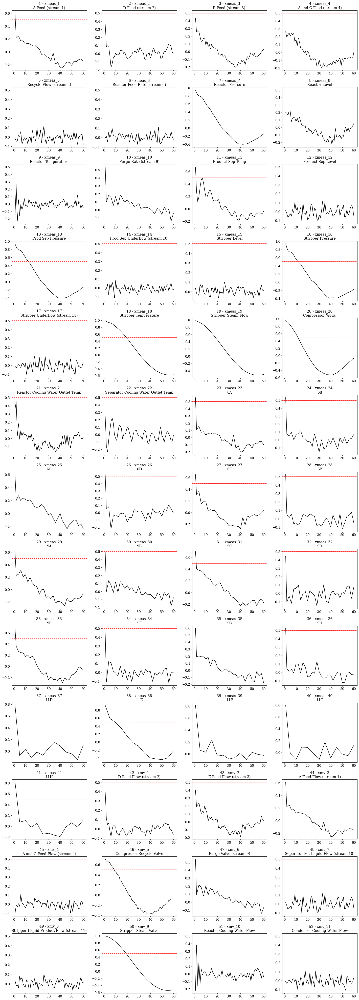

In [19]:
fig, ax = plt.subplots(13,4,figsize=(20,55))

lags_y = []
nlags = 60
lags_x = np.arange(1,nlags+1)

for i in range(df1.shape[1]):
    y = acf(df1.iloc[:,i],nlags=nlags)[1:]
    ax.ravel()[i].plot(lags_x, y,c='k')
    lags_y.append(y)
    ax.ravel()[i].axhline(0.5,c='r',ls='--')
    ax.ravel()[i].set_title(f'{i+1} - '+df1.iloc[:,i].name+'\n'+labels[i]);
    
fig.tight_layout()

The autocorrelation is low for most variables.

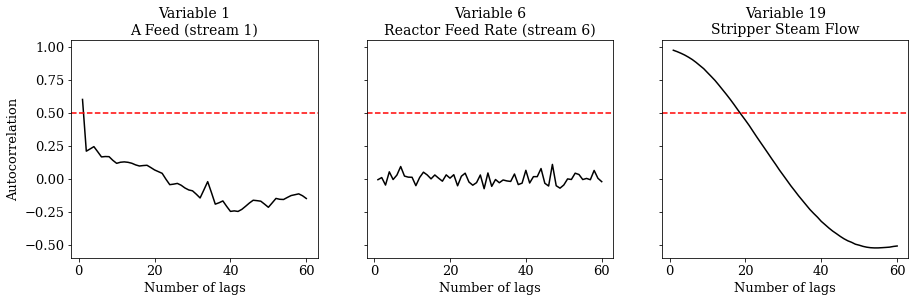

In [20]:
fig, ax = plt.subplots(1,3,figsize=(15,4),sharey=True)

autotoplot = [0,5,18]

for i in range(len(autotoplot)):
    
    ax[i].plot(lags_x, lags_y[autotoplot[i]],c='k')
    ax[i].axhline(0.5,c='r',ls='--')
    ax[i].set_title(f'Variable {autotoplot[i]+1}\n{names[autotoplot[i]]}')
    ax[i].set_xlabel('Number of lags')

ax[0].set_ylabel('Autocorrelation');

We can condense the information above into a bar graph showing the time required for each variable to reach autocorrelation of 0.5:

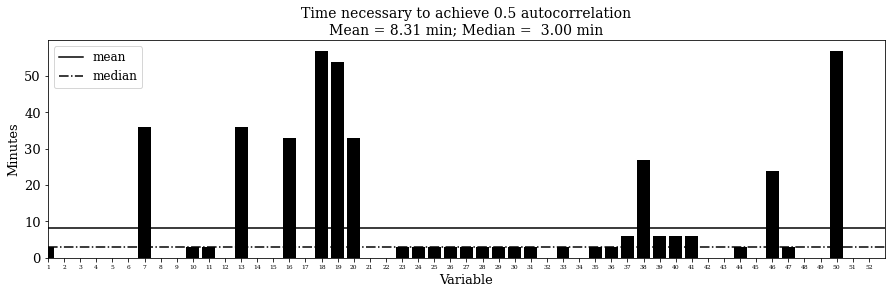

In [21]:
fig, ax = plt.subplots(figsize=(15,4))

auto_critic = [np.searchsorted(-lags_y[i],-0.5) for i in range(len(lags_y))]

plt.bar(np.arange(1,len(auto_critic)+1),np.array(auto_critic)*3,color='k');
plt.xlabel('Variable')
plt.ylabel('Minutes')
plt.title(f'Time necessary to achieve 0.5 autocorrelation\nMean = {np.mean(auto_critic)*3:.2f} min; Median =  {np.median(auto_critic)*3:.2f} min');
plt.xlim([1,df1.shape[1]+1]);
plt.xticks(np.arange(1,df1.shape[1]+1));
plt.gca().xaxis.set_tick_params(labelsize=6)
plt.axhline(np.mean(auto_critic)*3,ls='-',c='k',label='mean')
plt.axhline(np.median(auto_critic)*3,ls='-.',c='k',label='median')
plt.legend();

### Noise

The signal/noise ratio of each variable will be estimated by dividing the total variance by the average of the variances obtained in moving windows of size 2. For more details on this method, read [this paper](https://doi.org/10.1002/cjce.22219).

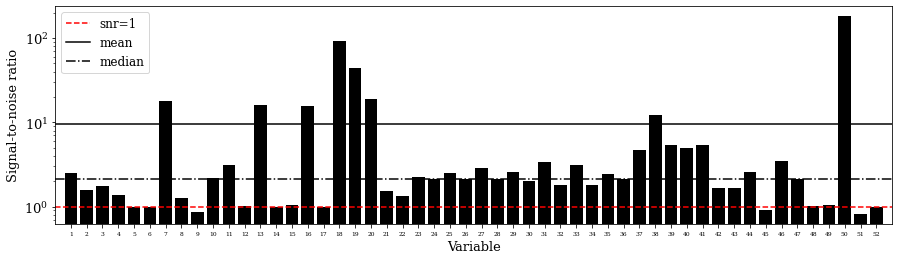

In [22]:
fig, ax = plt.subplots(figsize=(15,4))

c = kydlib.Study(df1)
c.signal_to_noise()
c.signal_to_noise_plot(ax=ax)

ax.xaxis.set_tick_params(labelsize=6)

In general, the variables have low signal-to-noise ratio, indicating that total variance is comparable in most cases to the measurement noise variance.

### Correlations

Linear and nonlinear correlations can be measured with Pearson and mutual information coefficients. For details on the procedure, check [this](https://doi.org/10.1021/acs.iecr.5b03525) and [this](https://doi.org/10.1016/j.softx.2021.100686) papers.

In [23]:
%%time
c = kydlib.Study(df1)
c.corr_coef(cols = cols_3min)

CPU times: user 2.62 s, sys: 174 ms, total: 2.8 s
Wall time: 1.37 s


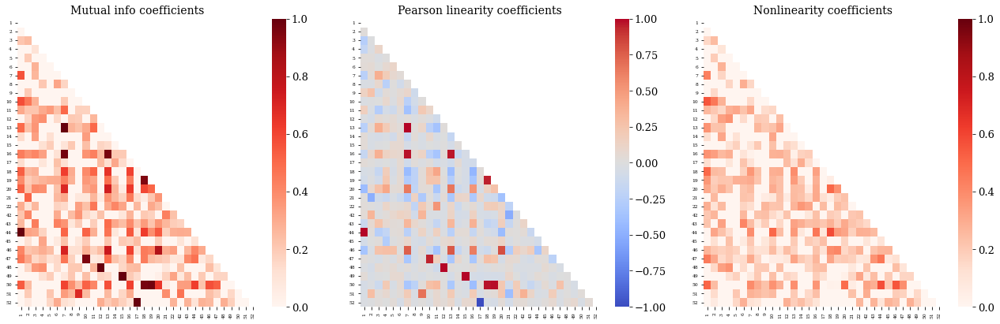

In [24]:
fig, ax = plt.subplots(1,3,figsize=(18,6))

c.corr_coef_plot(labels=ylabels_3min, ax=ax,title=False)

for i in range(3):

    ax[i].xaxis.set_tick_params(labelsize=6)
    ax[i].yaxis.set_tick_params(labelsize=6)

The variables show a low degree of correlation, both from a linear and non-linear point of view.

#### Applying moving average to denoise the dataset

The variables in this dataset are very noisy. Correlations tend to be sensitive to the level of noise, which can be reduced by filters. Here we will apply one of the most common and simplest filters, the moving average.



In [25]:
%%time

df1_filtered = []

W = [5,10,20,40,70,100]

for w in W:
    df1_filtered.append(filter_noise_ma(df1, W=w))

CPU times: user 132 ms, sys: 1.03 ms, total: 133 ms
Wall time: 139 ms


The following figure shows the results of applying filters in time series (darker colors correspond to longer window lengths):

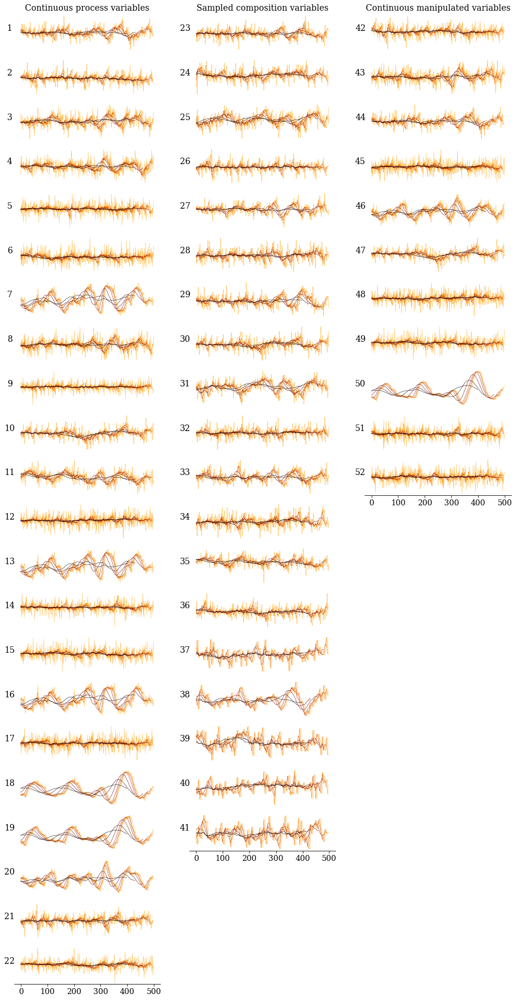

In [26]:
fig, ax = plt.subplots(22, 3, figsize=(15, 30))

colors = np.flip(plt.cm.afmhot(np.linspace(0,0.6,len(W)+1)),axis=0)

for i in range(22):
    ax[i,0].plot(df1.iloc[:,i].values,c=colors[0],linewidth=0.6,alpha=0.8)
    for k in range(len(W)):
        ax[i,0].plot(df1_filtered[k].iloc[:,i].values,c=colors[k+1],linewidth=0.5)
    ax[i,0].set_yticks([])
    ax[i,0].set_ylabel(i+1,rotation=0,fontsize=14)
    for j in range(3):
        ax[i,j].spines["top"].set_visible(False)
        ax[i,j].spines["right"].set_visible(False)
        ax[i,j].spines["left"].set_visible(False)
    if i<(22-1):
        ax[i,0].set_xticks([])
        ax[i,0].spines["bottom"].set_visible(False)
        
for i in range(19):
    ax[i,1].plot(df1.iloc[:,i+22].values,c=colors[0],linewidth=0.6,alpha=0.8)
    for k in range(len(W)):
        ax[i,1].plot(df1_filtered[k].iloc[:,i+22].values,c=colors[k+1],linewidth=0.5)
    ax[i,1].set_yticks([])
    ax[i,1].set_ylabel(i+23,rotation=0,fontsize=14)
    if i!=(19-1):
        ax[i,1].set_xticks([])
        ax[i,1].spines["bottom"].set_visible(False)
        
for i in range(11):
    ax[i,2].plot(df1.iloc[:,i+41].values,c=colors[0],linewidth=0.6,alpha=0.8)
    for k in range(len(W)):
        ax[i,2].plot(df1_filtered[k].iloc[:,i+41].values,c=colors[k+1],linewidth=0.5)
    ax[i,2].set_yticks([])
    ax[i,2].set_ylabel(i+42,rotation=0,fontsize=14)
    if i!=(11-1):
        ax[i,2].set_xticks([])
        ax[i,2].spines["bottom"].set_visible(False)

for i in range(19,22):
    ax[i,1].axis('off')
    
for i in range(11,22):
    ax[i,2].axis('off')
 
ax[0,0].set_title('Continuous process variables',fontsize=14)
ax[0,1].set_title('Sampled composition variables',fontsize=14)
ax[0,2].set_title('Continuous manipulated variables',fontsize=14);

Some variables are stationary, having all variability filtered out and resulting in a single set-point (e.g., 2, 5 and 6). Other variables have long-term dynamics highlighted (e.g. 18, 19 and 50).

The following figure shows the effect of filters on scatterplots of continuous process measurements.

CPU times: user 22.5 s, sys: 201 ms, total: 22.7 s
Wall time: 22.5 s


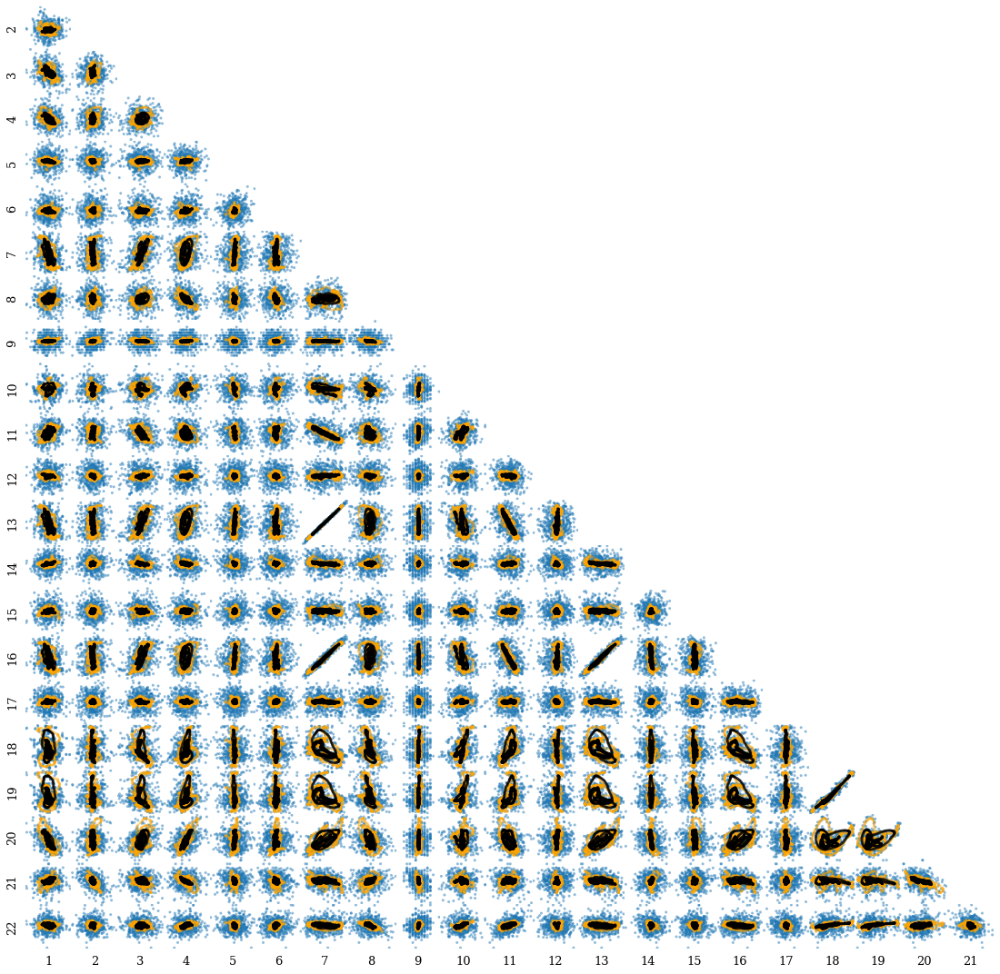

In [27]:
%%time
oi = pd.concat([df1.iloc[:,:22].assign(color=plt.rcParams['axes.prop_cycle'].by_key()['color'][0]), 
                df1_filtered[1].iloc[:,:22].assign(color='orange'),
                df1_filtered[3].iloc[:,:22].assign(color='k')])

oi.index = range(oi.shape[0])
oi.columns = np.arange(1,23).tolist()+['color']

sm = pd.plotting.scatter_matrix(oi,figsize=(20,20),color=oi['color'],alpha=0.5)

for i in range(len(sm)):
    for j in range(len(sm)):
        if i <= j:
            sm[i,j].set_visible(False)

for subaxis in sm:
    for ax in subaxis:
        ax.xaxis.set_ticks([])
        ax.yaxis.set_ticks([])
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)
#        ax.set_ylabel("")
#        ax.set_xlabel("")
pic = sm[0][0].get_figure();  

#pd.plotting.scatter_matrix(df_treino.iloc[:,:23],figsize=(20,20));

The scatterplots clearly show that some dynamic trajectories are highlighted by the filter. This causes the overall correlation coefficients to increase:

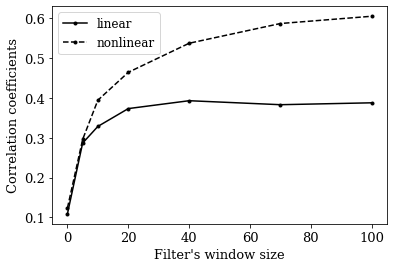

In [28]:
c1=[]

c1.append(c)

for j in range(len(W)):
    c1.append(kydlib.Study(df1_filtered[j][cols_3min]))
    c1[-1].corr_coef()

rho_i = [c1[i].rho for i in range(len(c1))]
r_i = [c1[i].r for i in range(len(c1))]
#v_i = np.array(rho_i)+np.array(r_i) # ta dando mais q 1! Investigar

plt.plot([0]+W,rho_i,marker='.',label='linear',c='k');
plt.plot([0]+W,r_i,marker='.',ls='--',label='nonlinear',c='k');
#plt.plot([0]+W,v_i,marker='.',label='MI');

plt.xlabel("Filter's window size")
plt.ylabel('Correlation coefficients');
plt.legend();

But we have to be cautious, because mutual information can increase while dependencies between variables are not being highlighted. Let's look at a specific pair of variables:

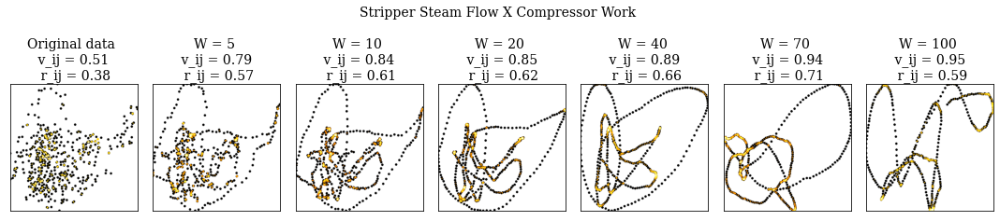

In [29]:
fig, ax = plt.subplots(1,7,figsize=(15,4))

df1_or_plus_filt = [df1]+df1_filtered

pair = (18,19)

for i in range(7):

    cvs = ds.Canvas()
    agg = cvs.points(df1_or_plus_filt[i], cols[pair[0]],cols[pair[1]])
    img = ds.tf.set_background(ds.tf.shade(ds.tf.spread(agg,px=5), cmap=cc.fire), "white").to_pil()
    ax.ravel()[i].imshow(img)
    ax.ravel()[i].xaxis.set_ticks([])
    ax.ravel()[i].yaxis.set_ticks([])
    if i==0: 
        ax.ravel()[i].set_title(f'Original data \n v_ij = {c1[i].vxy[pair[0],pair[1]]:.2f} \n r_ij = {c1[i].rxy[pair[0],pair[1]]:.2f}')
    else:
        ax.ravel()[i].set_title(f'W = {W[i-1]} \n v_ij = {c1[i].vxy[pair[0],pair[1]]:.2f} \n r_ij = {c1[i].rxy[pair[0],pair[1]]:.2f}')
    #plt.set_xlabel(cols[pairs[i][0]-1])#+' ('+variables['Unit'][pairs[i][0]+1]+')')
    #plt.set_ylabel(cols[pairs[i][1]-1])#+' ('+variables['Unit'][pairs[i][1]+1]+')')

fig.suptitle(f'{continuous[pair[0]]} X {continuous[pair[1]]}')
    
fig.tight_layout()

Indeed, the filters highlight the dynamic trajectories up to a point, beyond which the curve begins to distort. This distortion, however, also has the effect of increasing mutual information.

Conclusion: there are relationships between variables hidden by noise in the data, but caution is needed in the application of highlighting methods.

#### Sensibility to different datasets

How does the effect of filters on correlation coefficients vary across different simulations?

CPU times: user 2min 30s, sys: 9.42 s, total: 2min 40s
Wall time: 1min 19s


Text(0, 0.5, 'Correlation coefficients')

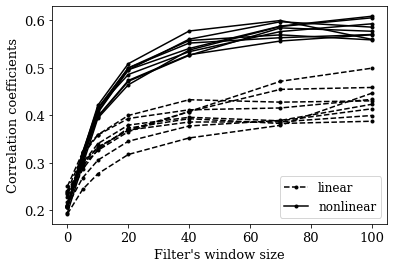

In [30]:
%%time

df_ = [train_normal_complete[(train_normal_complete.simulationRun==i)].iloc[:,3:] for i in range(1,10)]

for i in range(len(df_)):
    
    c_=[]

    c_.append(kydlib.Study(df_[i][cols_3min]))
    c_[0].corr_coef()
    
    df__filtered = []
    
    for w in W:
        df__filtered.append(filter_noise_ma(df_[i], W=w))

    for j in range(len(W)):
        c_.append(kydlib.Study(df__filtered[j][cols_3min]))
        c_[-1].corr_coef()

    plt.plot([0]+W,[c_[k].rho for k in range(len(c_))],marker='.',label='linear',ls='--',c='k');
    plt.plot([0]+W,[c_[k].r for k in range(len(c_))],marker='.',label='nonlinear',c='k');
    
    if i==0: plt.legend();
    
plt.xlabel("Filter's window size");
plt.ylabel('Correlation coefficients');

There are variations, but the general trends are the same.

## Control structure

The TEP process was proposed mainly to test control strategies. The strategy adopted in the generation of this dataset was proposed by [Lyman and Georgakis (1995)](https://www.sciencedirect.com/science/article/abs/pii/009813549400057U) and will be summarized below.

* **Strategy**: choose a variable at the center of the primary process path to manipulate the production rate, `XMEAS(17)` (stripper underflow). This causes changes in the production rate to propagate simultaneously in both directions, i.e. faster.
* **Variable chosen**: `XMV(11)`, condenser cooling water flow, which will close or open whenever there is, respectively, a decrease or increase in the production rate set-point.

Other important variables for the control loop:

* **Levels**
    * `XMEAS(8)`, reactor level.
        * As valve `XMV(11)` closes, the reactor level tends to increase, as the condenser outlet temperature increases and less of the $G$ and $H$ products are separated, returning to the reactor.
        * `XMEAS(8)` is controlled by `XMEAS(4)`, the flow rate of the stream $4$, which influences it considerably because it is the flow rate of greatest magnitude and contains both reactants $A$ and $C$.
        * `XMEAS(4)` is manipulated by `XMV(4)`.
    * `XMEAS(12)` and `XMEAS(15)`, separator and stripper levels.
        * As the `XMV(11)` valve closes, levels tend to decrease as less of the products $G$ and $H$ are condensed.
        * They are each controlled by their output rate, `XMV(7)` and `XMV(8)` respectively.
* **Temperature**
    * `XMEAS(9)`, reactor temperature.
        * It is controlled by `XMEAS(21)`, the reactor cooling water outlet temperature, which in turn is controlled in a slave loop by `XMV(10)`, the reactor cooling water flow rate. This cascading structure is useful for minimizing disturbances to the inlet cooling water temperature.
* **Balances per component**:
    * **Input**:
        * `XMEAS(23)`, concentration of $A$ in the reactor feed.
            * It is controlled by `XMEAS(1)`, the feed rate of stream $1$ (input of $A$ in the process), in turn manipulated by `XMV(3)`.
            * Stream $1$ is used to keep the concentration of $A$ constant in the reactor feed, offsetting any $A$ from stream $4$ that enters through the recycle.
        * `XMEAS(27)`, concentration of $E$ in the reactor feed.
            * It is controlled by `XMEAS(3)`, the feed rate of stream $3$ (input of $E$ in the process), in turn manipulated by `XMV(2)`.
            * Stream `3` is used to maintain a proper ratio of output products.
        * `XMEAS(26)`, concentration of $D$ in the reactor feed.
            * It is controlled by `XMEAS(1)`, the feed rate of stream $2$ (input of $D$ in the process), in turn manipulated by `XMV(1)`.
    * **Purge**:
         * `XMEAS(30)`, concentration of $B$ in the purge.
            * It is controlled by `XMEAS(10)`, the flow rate of stream $9$ (purge), in turn manipulated by `XMV(6)`.
            * The objective is to keep the composition of the inert $B$ constant in the recycle stream.
    * **Output**:
         * `XMEAS(38)`, concentration of $E$ at the output.
            * It is controlled by `XMEAS(18)`, the temperature of the stripper, which in turn is controlled in cascade by `XMEAS(19)`, the stripper steam flow, which is manipulated by `XMV(9)`.
            * The objective is to control the purity of the product at the exit, related to the $E$ because this is the heaviest impurity.
* **Flow rates**
    * `XMEAS(5)`, the recycle rate, manipulated by `XMV(5)`.
    
It should be noted that the gas inventory is not covered by the control structure (thus leaving out pressure measurements and compressor work). The reactor pressure, `XMEAS(7)`, despite influencing the process through variations in reaction rates, is not controlled and fluctuates freely.

## Fault analysis

There are 5 types of faults in the dataset: 

* step;
* random variation;
* slow drift;
* sticking;
* unknown.

### List of faults

Fault | Description
-------- | -----------
`IDV(1)`  | A/C Feed Ratio, B Composition Constant (Stream 4)          Step
`IDV(2)`  | B Composition, A/C Ratio Constant (Stream 4)               Step
`IDV(3)`  | D Feed Temperature (Stream 2)                              Step
`IDV(4)`  | Reactor Cooling Water Inlet Temperature                    Step
`IDV(5)`  | Condenser Cooling Water Inlet Temperature                  Step
`IDV(6)`  | A Feed Loss (Stream 1)                                     Step
`IDV(7)`  | C Header Pressure Loss - Reduced Availability (Stream 4)   Step
`IDV(8)`  | A, B, C Feed Composition (Stream 4)            Random Variation
`IDV(9)`  | D Feed Temperature (Stream 2)                  Random Variation
`IDV(10)` | C Feed Temperature (Stream 4)                  Random Variation
`IDV(11)` | Reactor Cooling Water Inlet Temperature        Random Variation
`IDV(12)` | Condenser Cooling Water Inlet Temperature      Random Variation
`IDV(13)` | Reaction Kinetics                                    Slow Drift
`IDV(14)` | Reactor Cooling Water Valve                            Sticking
`IDV(15)` | Condenser Cooling Water Valve                          Sticking
`IDV(16)` | Unknown
`IDV(17)` | Unknown
`IDV(18)` | Unknown
`IDV(19)` | Unknown
`IDV(20)` | Unknown

### Training a PCA model

We will apply a simple PCA model to help us understand faults and generate baseline fault detection results.

In [31]:
df1_train = train_normal_complete[(train_normal_complete.simulationRun>=1)&(train_normal_complete.simulationRun<=5)].iloc[:,3:]
df1_val = train_normal_complete[(train_normal_complete.simulationRun>=6)&(train_normal_complete.simulationRun<=10)].iloc[:,3:]
df2_val = train_normal_complete[(train_normal_complete.simulationRun>=11)&(train_normal_complete.simulationRun<=15)].iloc[:,3:]

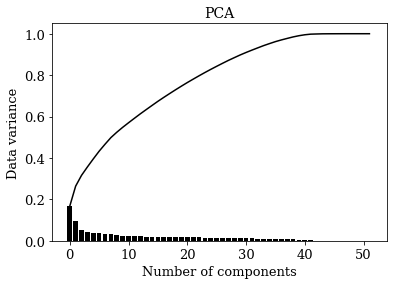

In [32]:
pca = PCA()
pca.fit(df1_train,plot=True)

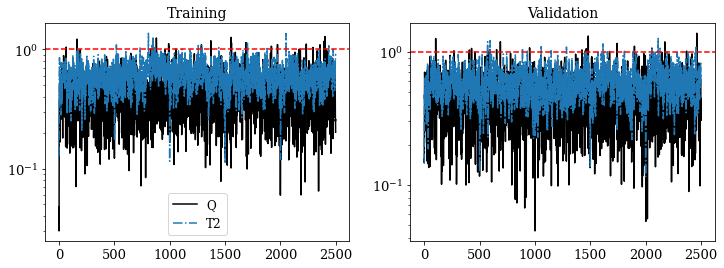

In [33]:
fig, ax = plt.subplots(1,2,figsize=(12,4))

ax[0].semilogy(pca.KPI_train['Q']/pca.KPI_lim['Q']['percentile'],c='k',label='Q')
ax[0].semilogy(pca.KPI_train['T2']/pca.KPI_lim['T2']['percentile'],ls='-.',label='T2')

pca.predict(df1_val, redefine_lim = True)

ax[1].semilogy(pca.KPI_test['Q']/pca.KPI_lim['Q']['percentile'],c='k',label='Q')
ax[1].semilogy(pca.KPI_test['T2']/pca.KPI_lim['T2']['percentile'],ls='-.',label='T2')

ax[0].set_title('Training');
ax[1].set_title('Validation');

ax[0].legend();

for i in range(2):
    ax[i].axhline(1,c='r',ls= '--');

In [34]:
pca.predict(df2_val, compute_far = True)

fdrs = np.zeros(20) # to store fault detection rates

print('PCA - False alarm rates\n--------')
pca.far

PCA - False alarm rates
--------


{'T2': {'theoretical': 0.01, 'percentile': 0.008},
 'Q': {'theoretical': 0.0208, 'percentile': 0.0124},
 'comb': {'theoretical': 0.0308, 'percentile': 0.0204}}

The percentile detection threshold has lower false alarm rates than the theoretical threshold.

### Function to plot faults

In [35]:
def plot_tep_fault(idv):
    
    df1_faulty = test_faulty_complete[(test_faulty_complete.simulationRun==1)&(test_faulty_complete.faultNumber==idv)].iloc[:,3:]
        
    fig, ax = plt.subplots(22, 3, figsize=(15, 30))

    for i in range(22):
        ax[i,0].plot(df1.iloc[:,i].values,c='k',linewidth=0.8)
        ax[i,0].plot(df1_faulty.iloc[:,i].values,c='r',linewidth=0.8)
        ax[i,0].axvline(160, ls='--')
        ax[i,0].set_yticks([])
        ax[i,0].set_ylabel(i+1,rotation=0,fontsize=14)
        for j in range(3):
            ax[i,j].spines["top"].set_visible(False)
            ax[i,j].spines["right"].set_visible(False)
            ax[i,j].spines["left"].set_visible(False)
        if i<(22-1):
            ax[i,0].set_xticks([])
            ax[i,0].spines["bottom"].set_visible(False)

    for i in range(19):
        ax[i,1].plot(df1.iloc[:,i+22].values,c='k',linewidth=0.8)
        ax[i,1].plot(df1_faulty.iloc[:,i+22].values,c='r',linewidth=0.8)
        ax[i,1].axvline(160, ls='--')
        ax[i,1].set_yticks([])
        ax[i,1].set_ylabel(i+23,rotation=0,fontsize=14)
        if i!=(19-1):
            ax[i,1].set_xticks([])
            ax[i,1].spines["bottom"].set_visible(False)

    for i in range(11):
        ax[i,2].plot(df1.iloc[:,i+41].values,c='k',linewidth=0.8)
        ax[i,2].plot(df1_faulty.iloc[:,i+41].values,c='r',linewidth=0.8)
        ax[i,2].axvline(160, ls='--')
        ax[i,2].set_yticks([])
        ax[i,2].set_ylabel(i+42,rotation=0,fontsize=14)
        if i!=(11-1):
            ax[i,2].set_xticks([])
            ax[i,2].spines["bottom"].set_visible(False)

    for i in range(19,22):
        ax[i,1].axis('off')

    for i in range(11,22):
        ax[i,2].axis('off')

    ax[0,0].set_title('Continuous process variables',fontsize=14)
    ax[0,1].set_title('Sampled composition variables',fontsize=14)
    ax[0,2].set_title('Continuous manipulated variables',fontsize=14);
    
    pca.predict(df1_faulty,mask_fault=np.array([0]*160+[1]*800))
    fdrs[idv-1] = 100*pca.fdr['comb']['percentile']
    
    fig, ax = plt.subplots(figsize=(12,4))

    plt.semilogy(pca.KPI_test['Q']/pca.KPI_lim['Q']['percentile'],c='k',label='Q')
    plt.semilogy(pca.KPI_test['T2']/pca.KPI_lim['T2']['percentile'],ls='-.',label='T2')
    #plt.axvline(160,c='r',ls='-');
    plt.axvspan(160, 960, alpha=0.2, color='red')
    plt.axhline(1,c='r',ls= '--')
    plt.title(f"IDV({idv})\nPCA FDR = {fdrs[idv-1]:.2f}%");
    plt.legend();

### IDV(1) - A/C Feed Ratio, B Composition Constant (Stream 4) Step

* Abrupt fault, with return to a steady state with conditions different from the initial one.
* Main effect: the feed rate of $A$ from the recycle drops. The control loop reacts by increasing the supply of $A$ in stream 1. The two effects compensate each other and, over time, the composition of $A$ in stream 6 stabilizes.
* As there is a parallel reaction $A+E\rightarrow F$, after some time the fall in the concentration of $A$ causes `XMEAS(38)`, the concentration of $E$ in the output 11, to increase. This requires large fluctuations in the variables related to the stripper's temperature and steam flow, related to the control of `XMEAS(38)`.
* Uncontrolled variables related to gas inventory fluctuate widely.
* Very easy detection.

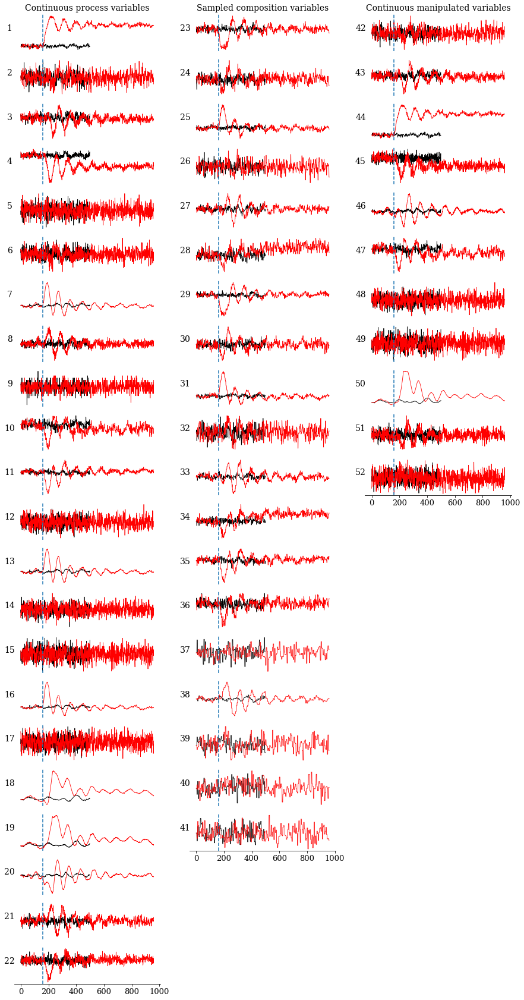

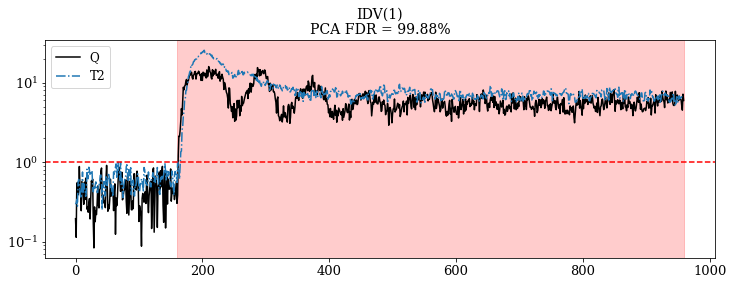

In [36]:
plot_tep_fault(1)

### IDV(2) - B Composition, A/C Ratio Constant (Stream 4) Step

* Abrupt fault, with return to a steady state with conditions different from the initial one.
* Main effect: `XMEAS(30)`, the concentration of $B$ in the purge stream, increases. The control reacts by increasing `XMEAS(10)`, the purge rate, which stabilizes at a higher level, causing `XMEAS(30)` to return to the set-point.
* As the ratio of $A+C$ falls relative to $B$, fewer products are formed and the reactor level, `XMEAS(8)`, tends to fall; the control loop, however, is quite effective in responding to this effect by increasing `XMEAS(4)`, the flow rate of current 4, to a slightly higher level.
* Uncontrolled variables related to the gas inventory have a jump at the beginning of the fault and then stabilize.
* Very easy detection.

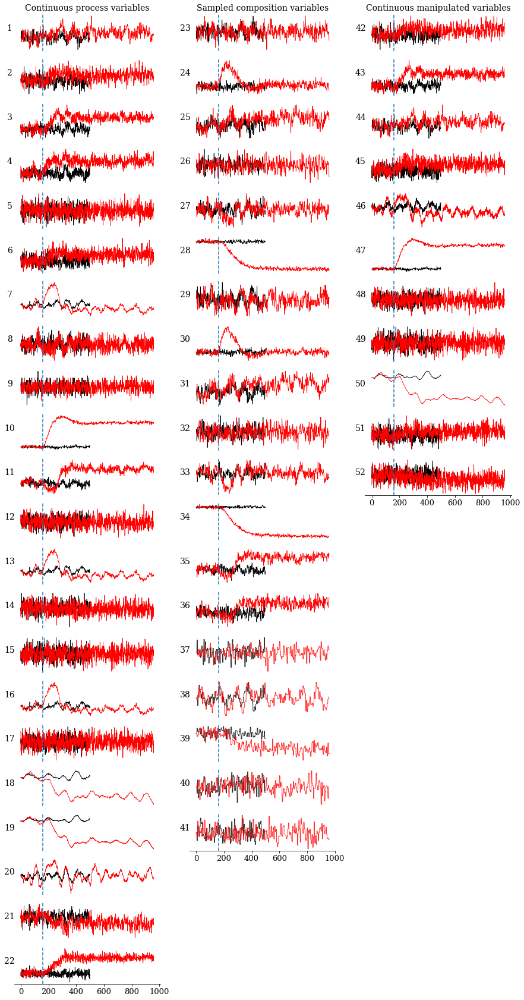

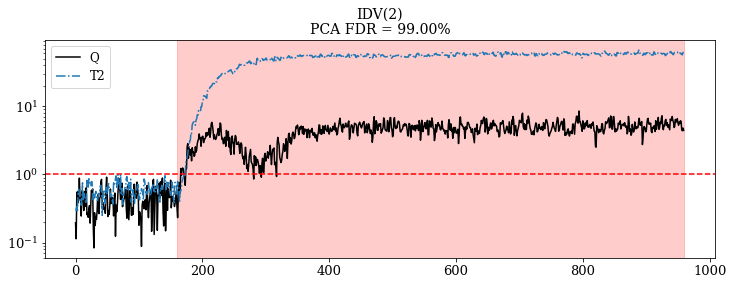

In [37]:
plot_tep_fault(2)

### IDV(3) -  D Feed Temperature (Stream 2) Step

* Fault compensated by the control loop actuation, with no apparent effects on the variables.
* Very difficult detection.

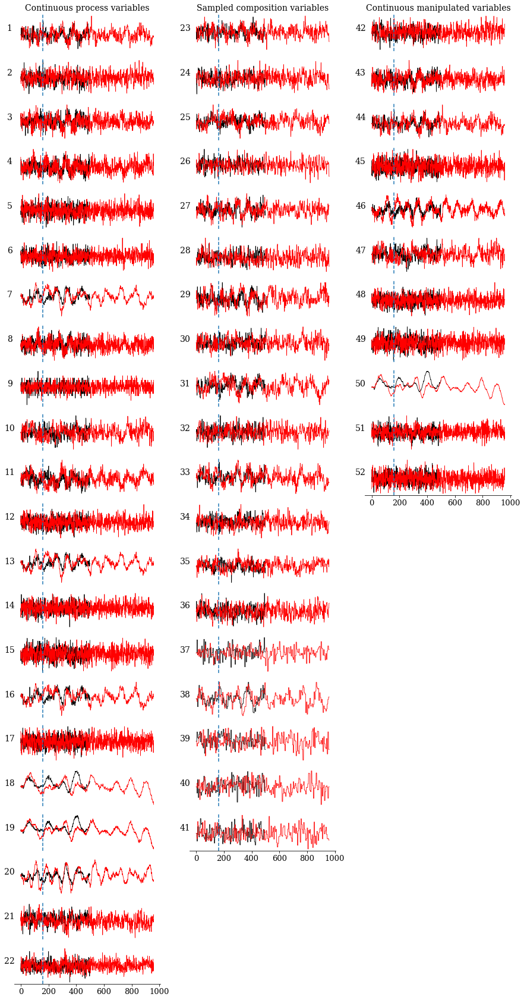

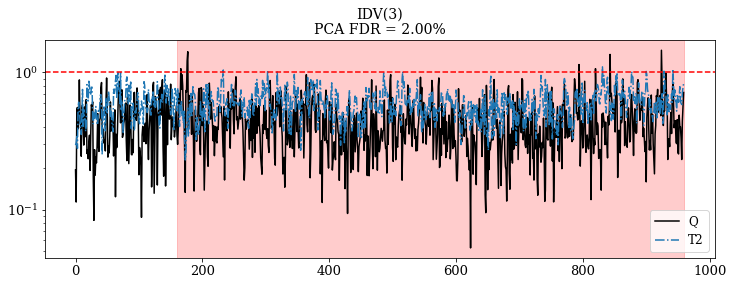

In [38]:
plot_tep_fault(3)

### IDV(4) - Reactor Cooling Water Inlet Temperature Step

* There is a sudden increase in the reactor temperature, `XMEAS(9)`, which the control almost instantly compensates for with a step in the flow rate of the cooling water, `XMV(10)`.
* Easy detection considering the behavior of the two variables mentioned above.

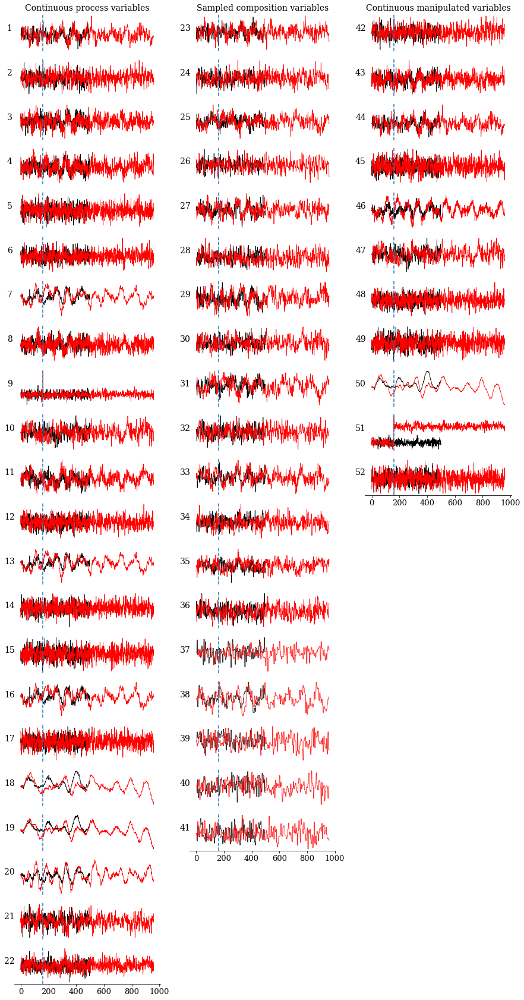

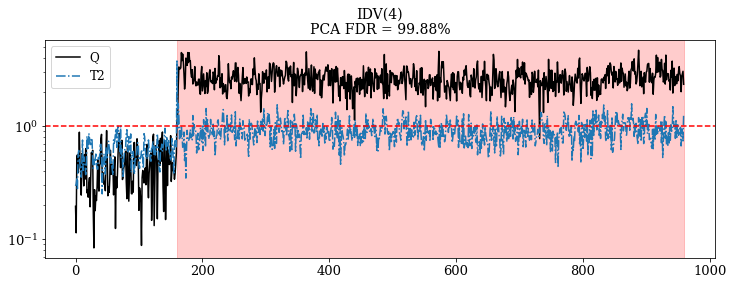

In [39]:
plot_tep_fault(4)

### IDV(5) - Condenser Cooling Water Inlet Temperature Step

* Abrupt oscillatory fault, with return to a steady state with conditions similar to the initial one.
* The effects of this fault are more complex than the previous one, as the temperature in the condenser is not directly controlled but influences the separation process in the equipment later on.
* Despite the complexity, it is easily verified that many of the variables are disturbed and return to their original values after a certain time, with the exception of the condenser cooling water flow, which reaches a slightly higher level in its new steady state.
* Easy detection at first, but the return of almost all the variables to the initial steady state levels tends to lower the fault detection rate.

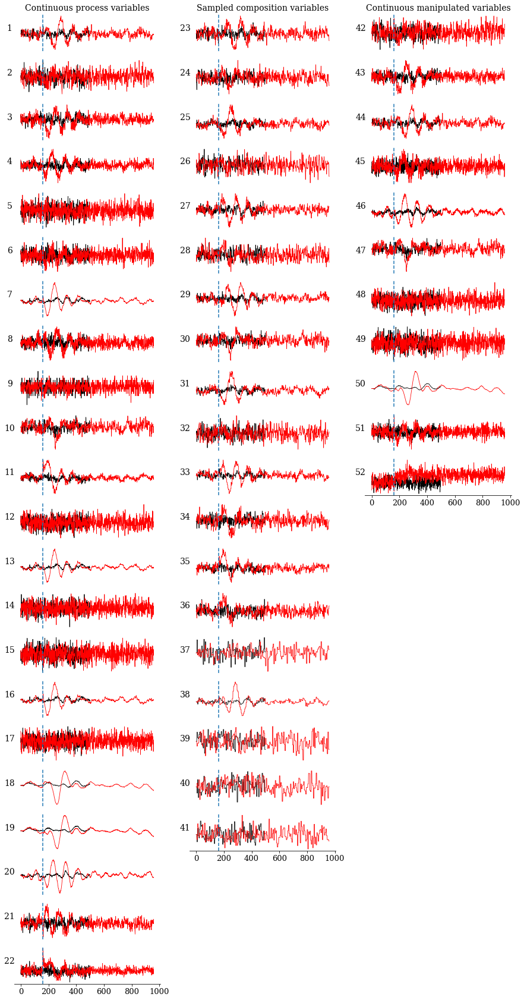

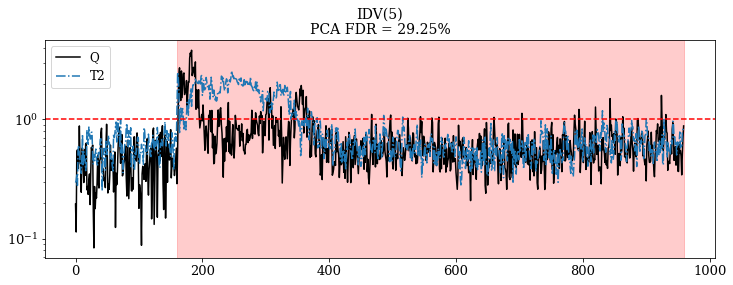

In [40]:
plot_tep_fault(5)

### IDV(6) - A Feed Loss (Stream 1)                                     Step

* Abrupt fault.
* With the supply of $A$ in stream $1$ dropping to zero abruptly, along the process, there begins to be a decrease in the amount of $A$ and an accumulation of the other reactants, $C$ and $E$.
* Some variables freeze after a certain point, for a reason apparently related to some safety limit, maybe the reactor pressure due to the accumulation of the other reagents.
* Very easy detection.

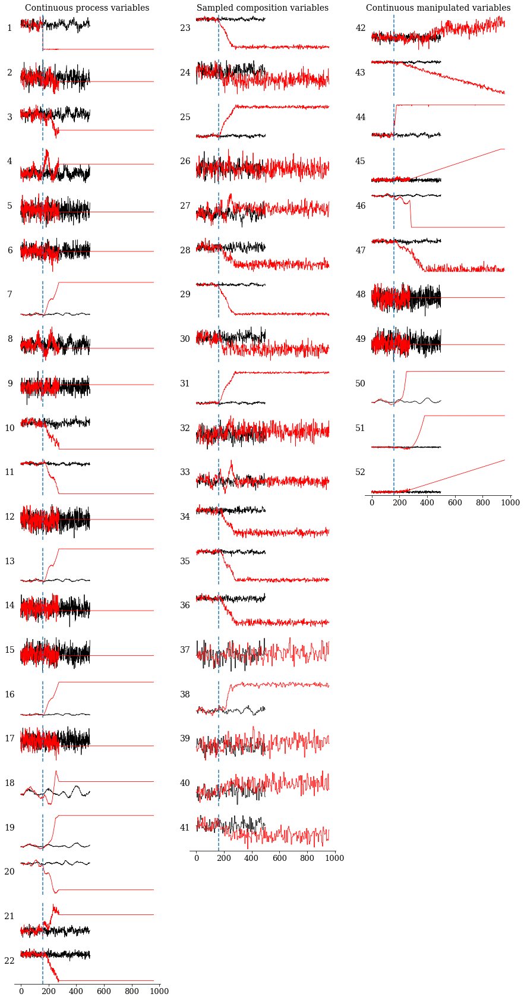

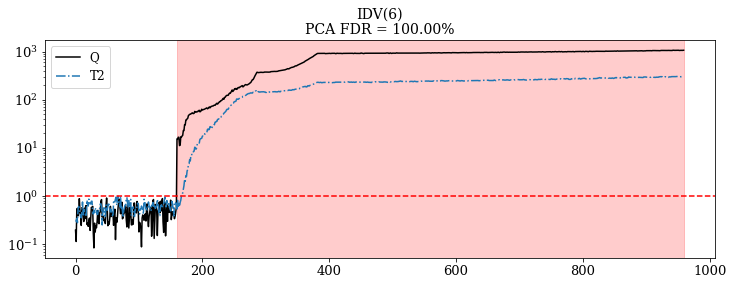

In [41]:
plot_tep_fault(6)

### IDV(7) - C Header Pressure Loss - Reduced Availability (Stream 4)   Step

* Abrupt oscillatory fault, with return to a steady state with conditions simmilar to the initial one.
* Many of the variables are perturbed and return to their original values after a certain time, with the exception of the valve opening of stream $4$, `XMV(4)`, which reaches a higher threshold after a certain time.
* Easy detection.

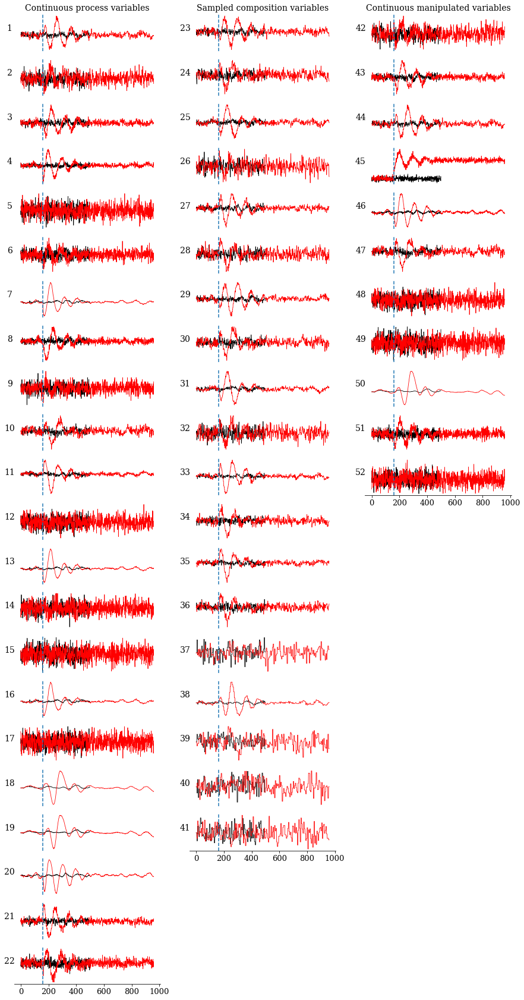

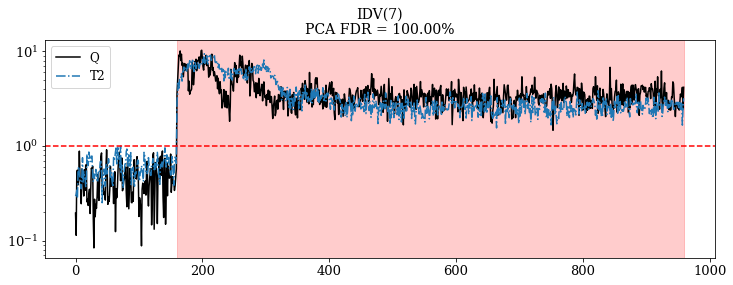

In [42]:
plot_tep_fault(7)

### IDV(8) - A, B, C Feed Composition (Stream 4) Random Variation

* Abrupt oscillatory fault with no return to a new steady state.
* As stream $4$ is a stream that contains the three reactants, the process is profoundly affected, causing severe fluctuations in many of the variables.
* Easy detection, with the exception of a short interval at the beginning of the fault where its effects are not yet apparent.

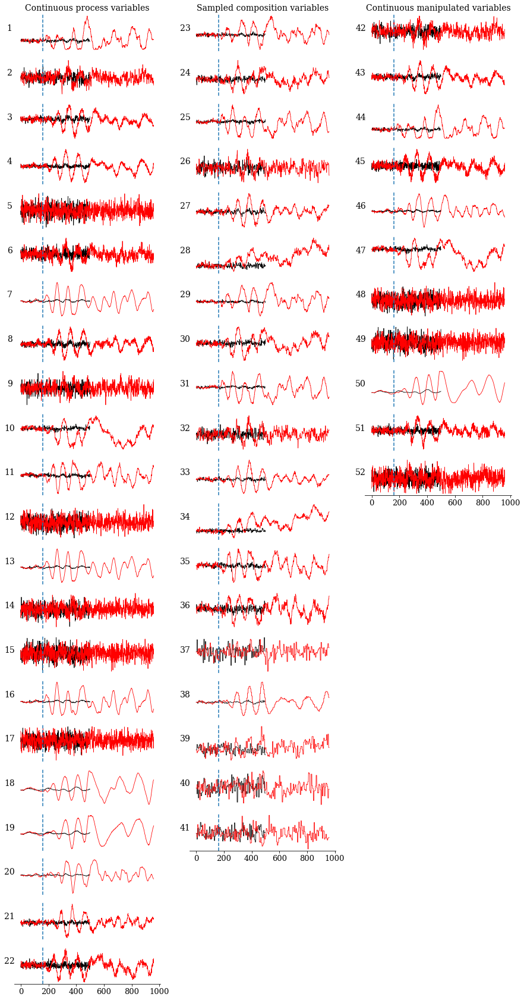

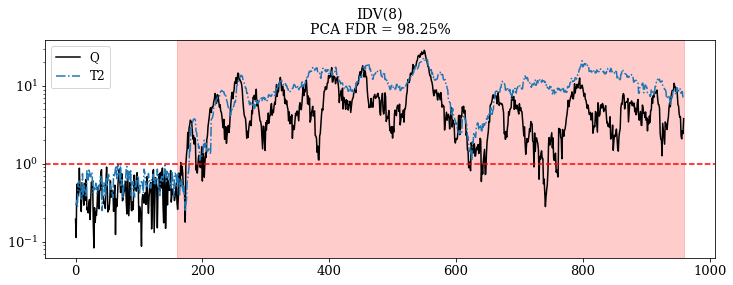

In [43]:
plot_tep_fault(8)

### IDV(9) - D Feed Temperature (Stream 2)                  Random Variation

* As with `IDV(3)`, which also involves changes in the temperature of stream $2$, the effects on the behavior of the variables are not visible.
* Very difficult detection.


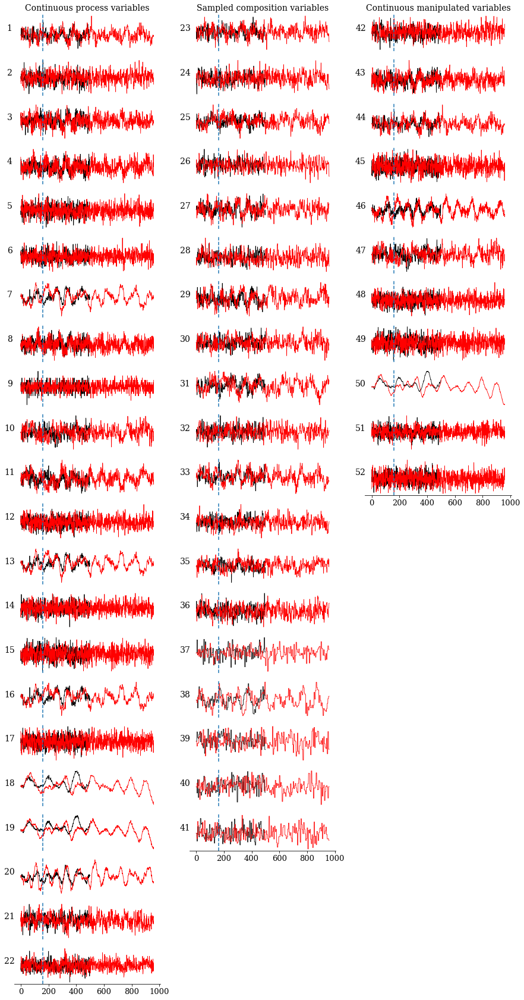

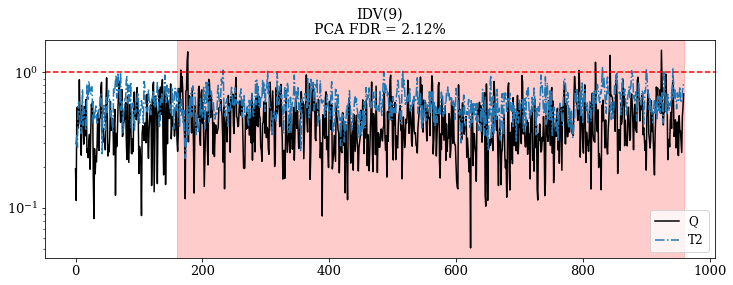

In [44]:
plot_tep_fault(9)

### IDV(10) - C Feed Temperature (Stream 4)                  Random Variation

* The stream $4$ enters the stripper directly; as it has a slightly more "nervous" controller, the effects of this fault are verified with large fluctuations in stripper-related variables such as temperature, `XMEAS(18)` and steam flow, `XMEAS(19)`.
* Moderate difficulty detection.


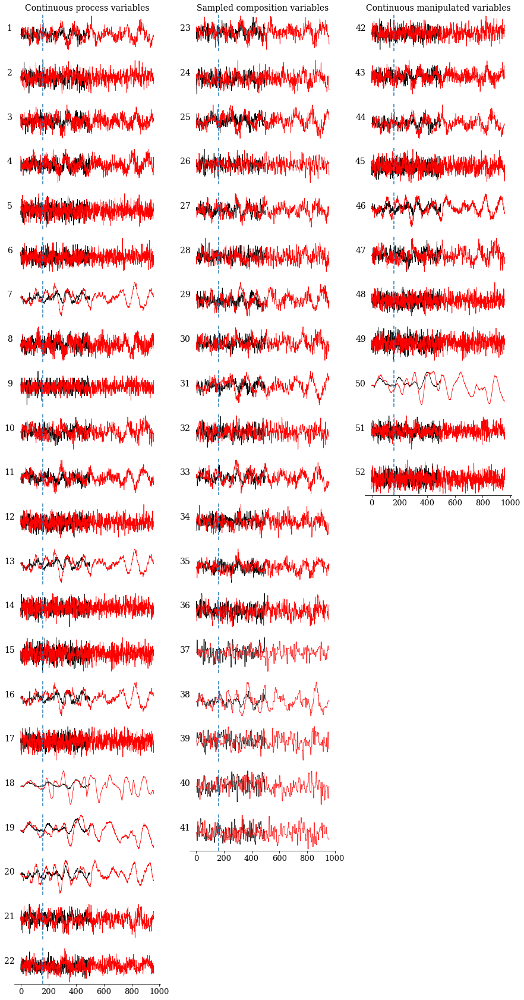

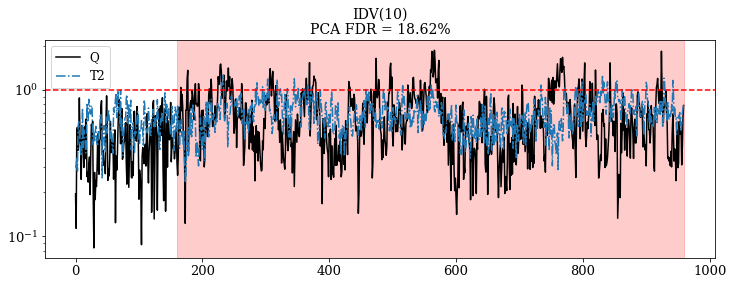

In [45]:
plot_tep_fault(10)

### IDV(11) - Reactor Cooling Water Inlet Temperature        Random Variation

* It is analogous to the `IDV(4)` fault, affecting the same two variables: reactor temperature `XMEAS(9)` and cooling water flow rate `XMV(10)`. However, because it is random variation and not a step, the control has difficulty keeping `XMEAS(9)` at its set-point.
* Moderate difficulty to easy detection, benefiting from the addition of dynamic information (lags). Multivariate models can have difficulty because all other variables remain largely unchanged.


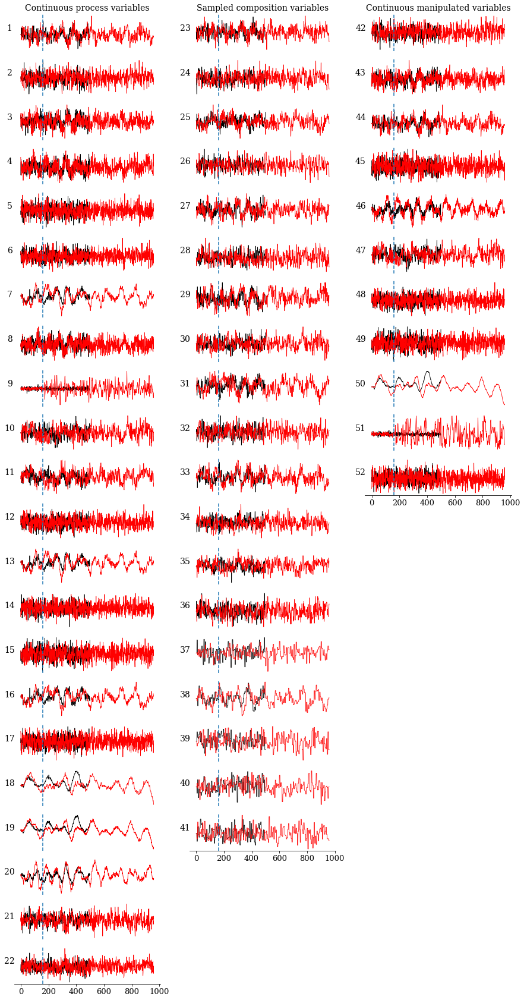

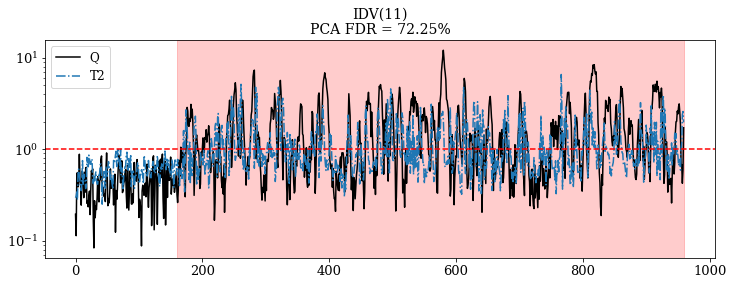

In [46]:
plot_tep_fault(11)

### IDV(12) - Condenser Cooling Water Inlet Temperature      Random Variation

* Like the `IDV(5)` fault relative to the `IDV(4)` fault, this fault is more complex than the `IDV(11)` because the temperature in the condenser is not directly controlled but influences the separation process in the equipment later. It causes large-amplitude fluctuations in many variables.
* Easy detection, with the exception of a very short interval at the beginning of the fault where its effects are not yet so obvious.


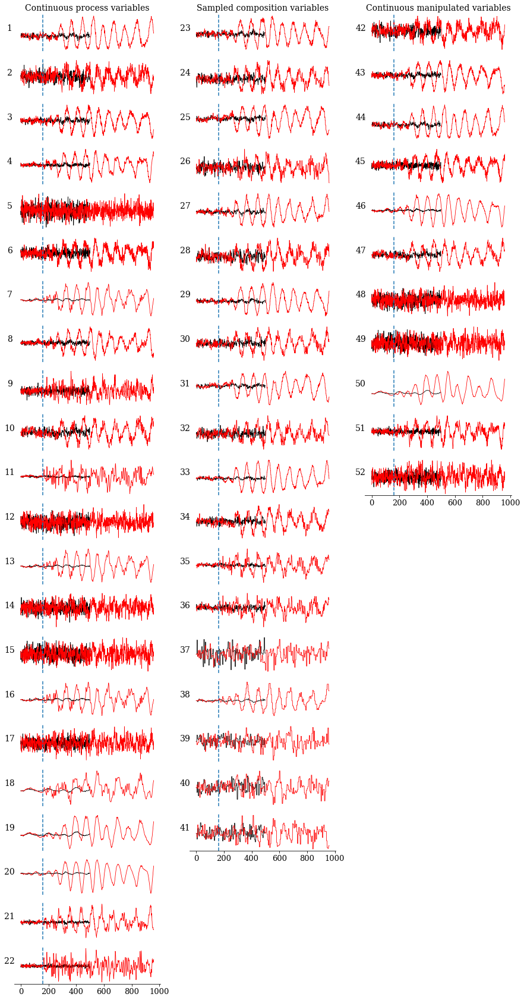

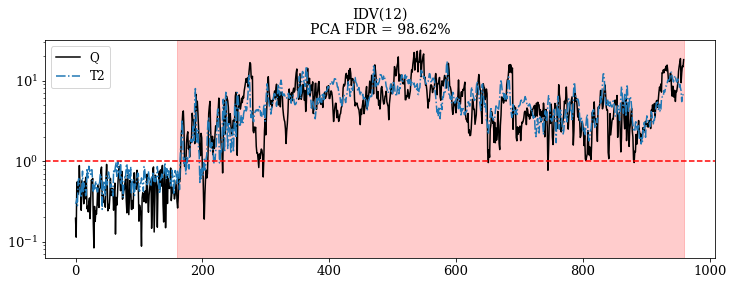

In [47]:
plot_tep_fault(12)

### IDV(13) - Reaction Kinetics                                    Slow Drift

* Incipient fault.
* It takes a while, but many variables fluctuate in response to this fault, especially those related to the stripper.
* Easy detection.


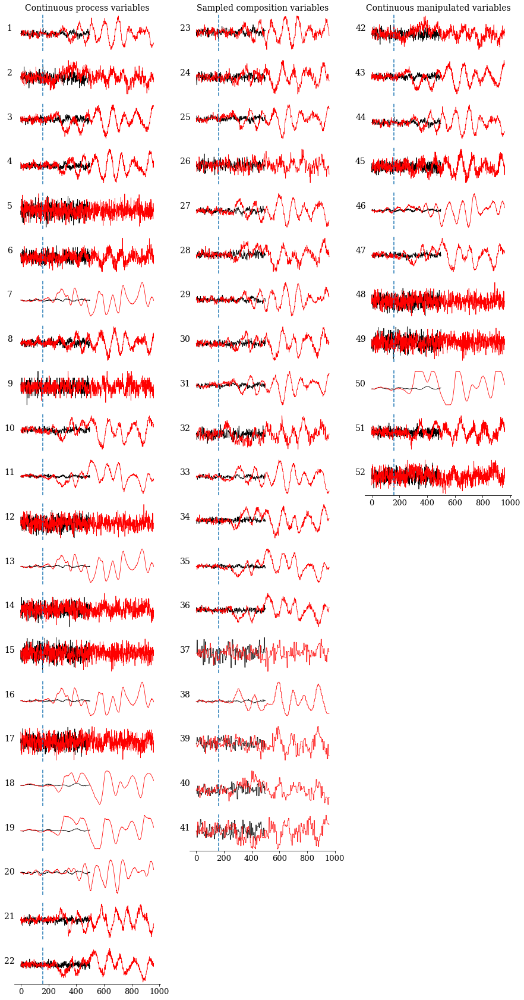

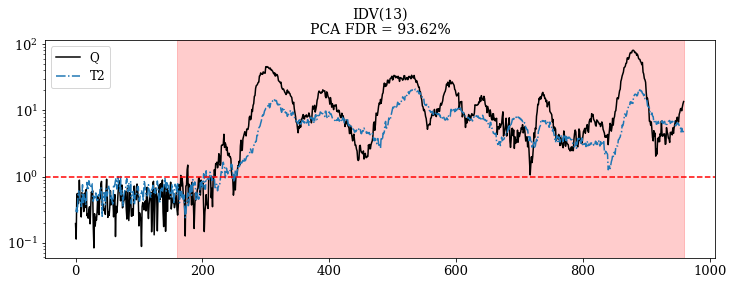

In [48]:
plot_tep_fault(13)

### IDV(14) - Reactor Cooling Water Valve                            Sticking

* This fault is reflected in the variables related to the reactor, whose variability is clearly increased: `XMEAS(9)`, reactor temperature; `XMEAS(21)`, the temperature of the reactor cooling water; `XMV(10)`, reactor cooling water valve opening.
* Easy detection.


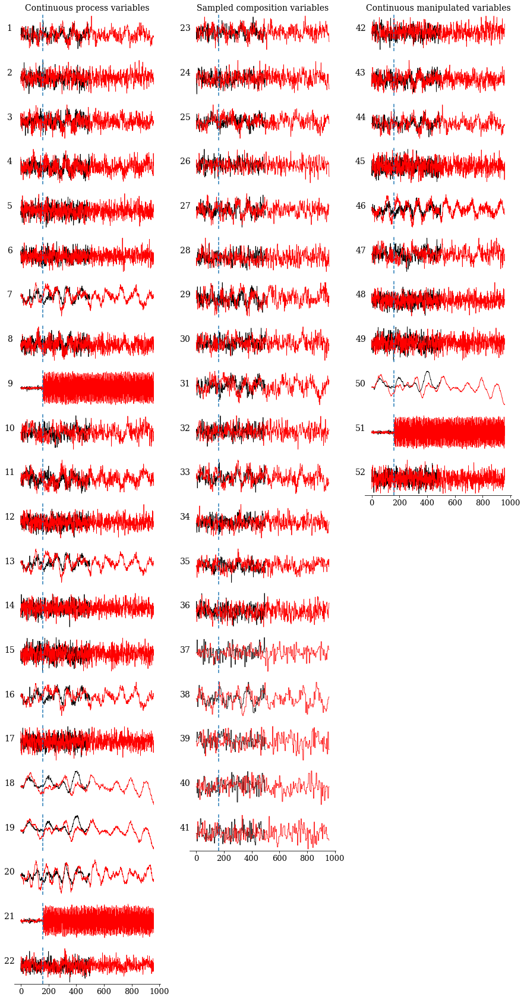

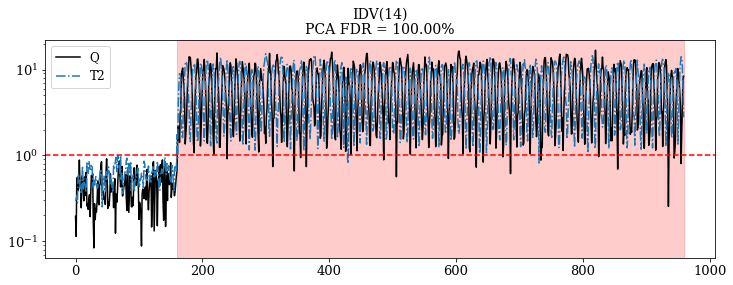

In [49]:
plot_tep_fault(14)

### IDV(15) - Condenser Cooling Water Valve                          Sticking


* As with `IDV(3)` and `IDV(9)`, the effects on the behavior of the variables are not visible.
* Very difficult detection.


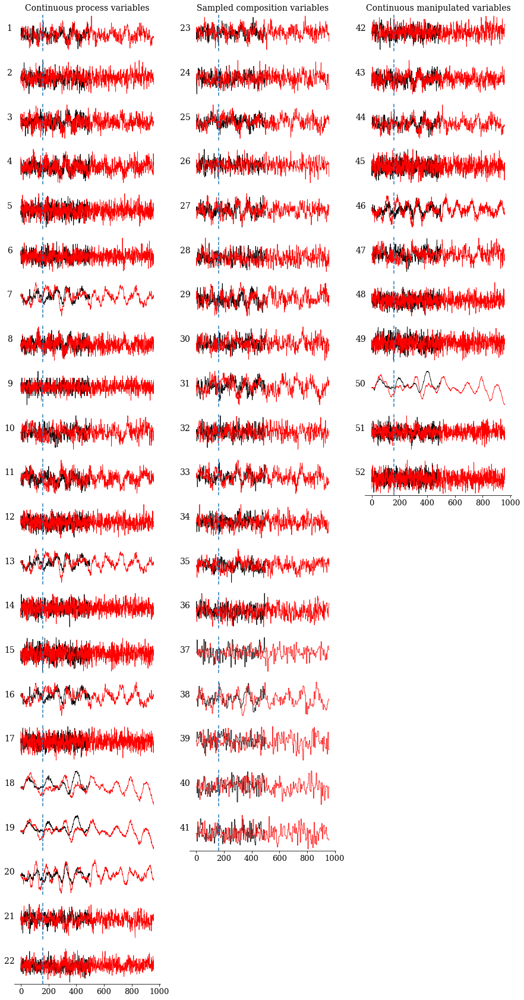

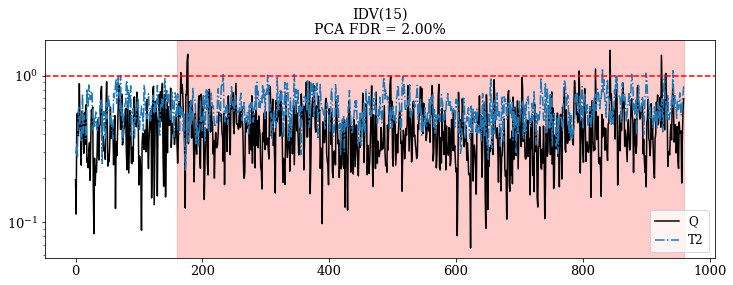

In [50]:
plot_tep_fault(15)

### IDV(16) - Unknown

* Visually, the variables affected appear to be those related to the stripper: temperature, `XMEAS(18)` and steam flow, `XMEAS(19)`.
* Moderate difficulty detection.

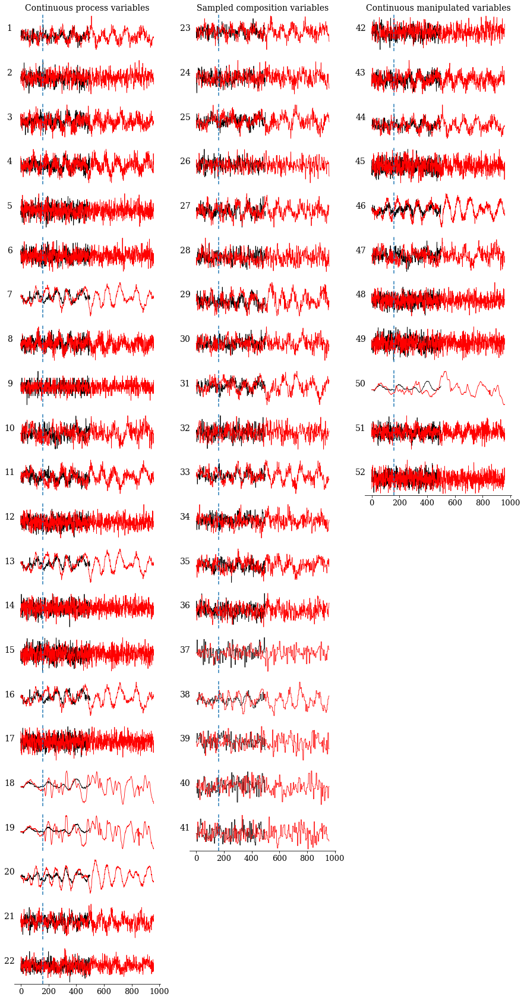

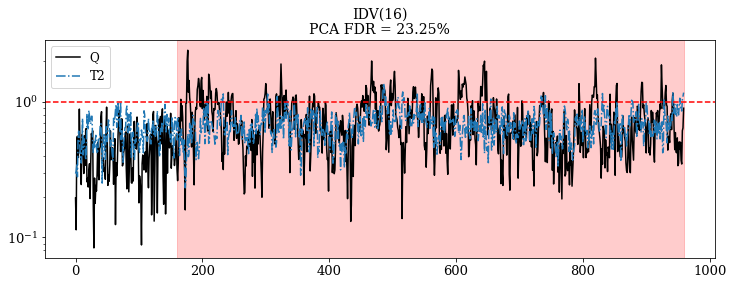

In [51]:
plot_tep_fault(16)

### IDV(17) - Unknown

* Visually, the affected variables appear to be those related to the reactor: the temperature, `XMEAS(9)` and the cooling water temperature, `XMEAS(21)`.
* Easy detection.


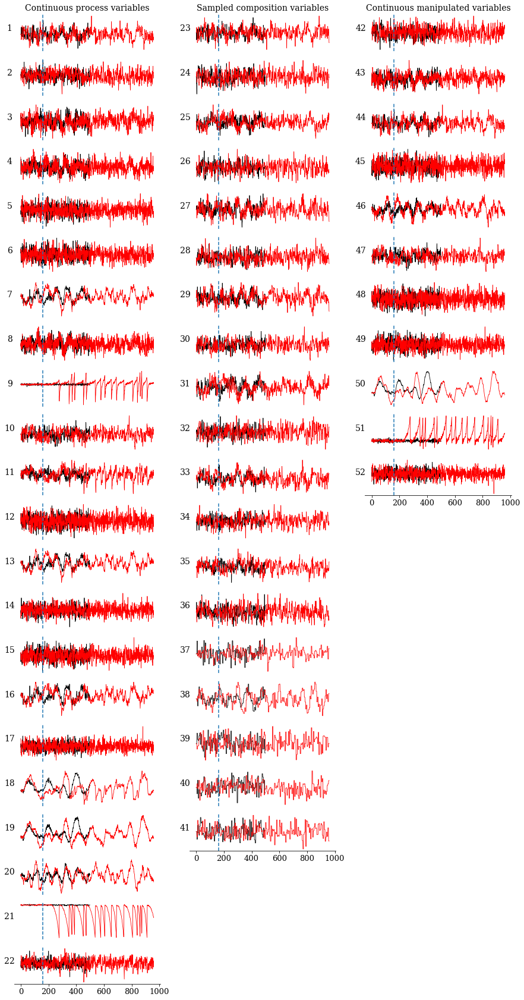

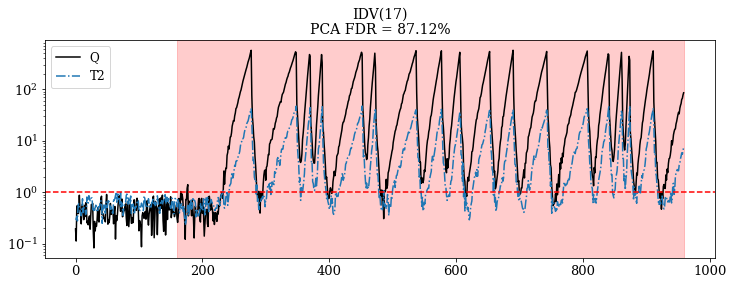

In [52]:
plot_tep_fault(17)

### IDV(18) - Unknown

* Visually, it appears to be of the same nature as the `IDV(6)` fault, but takes longer to make itself felt.
* Easy detection.


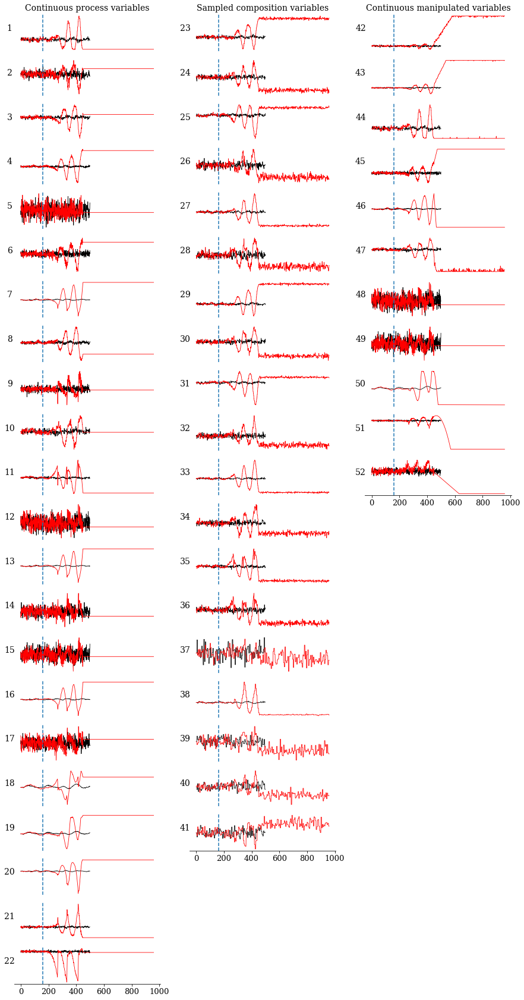

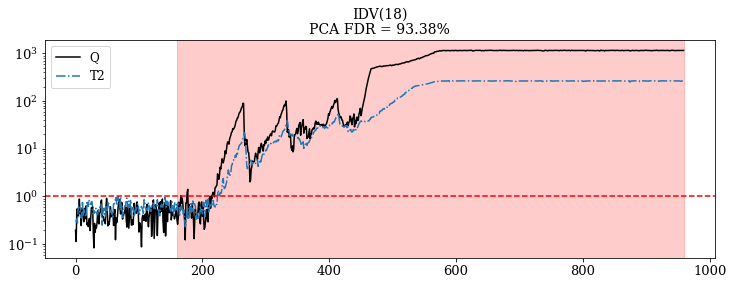

In [53]:
plot_tep_fault(18)

### IDV(19) - Unknown

* Visually, it appears to be related to the recycle flow, `XMEAS(5)`.
* Moderate difficulty detection.


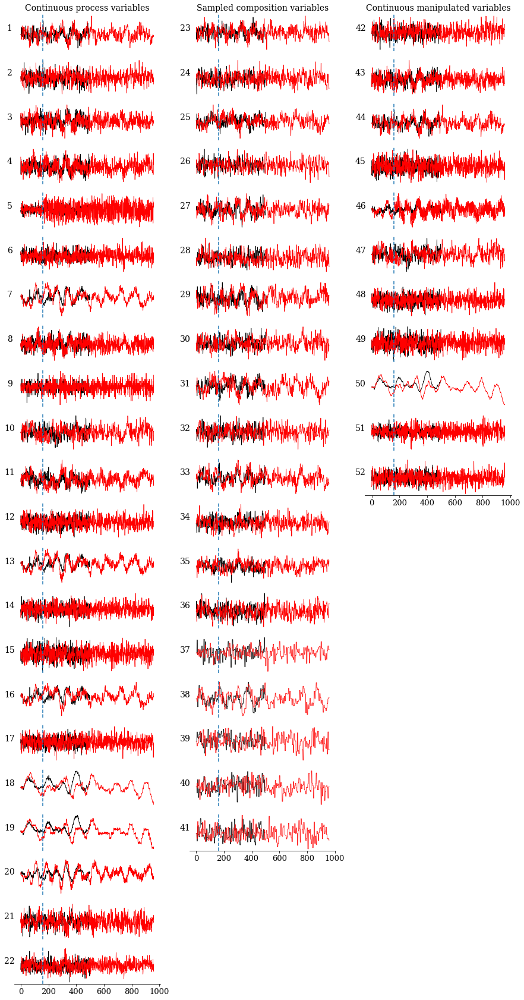

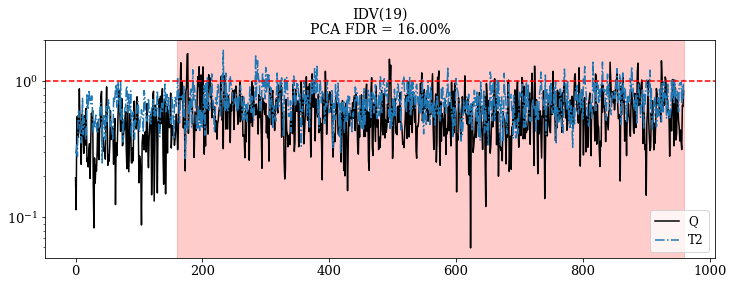

In [54]:
plot_tep_fault(19)

### IDV(20) - Unknown

* Visually, it seems to be related to the compressor work, `XMEAS(20)`.
* Moderate to easy difficulty detection.

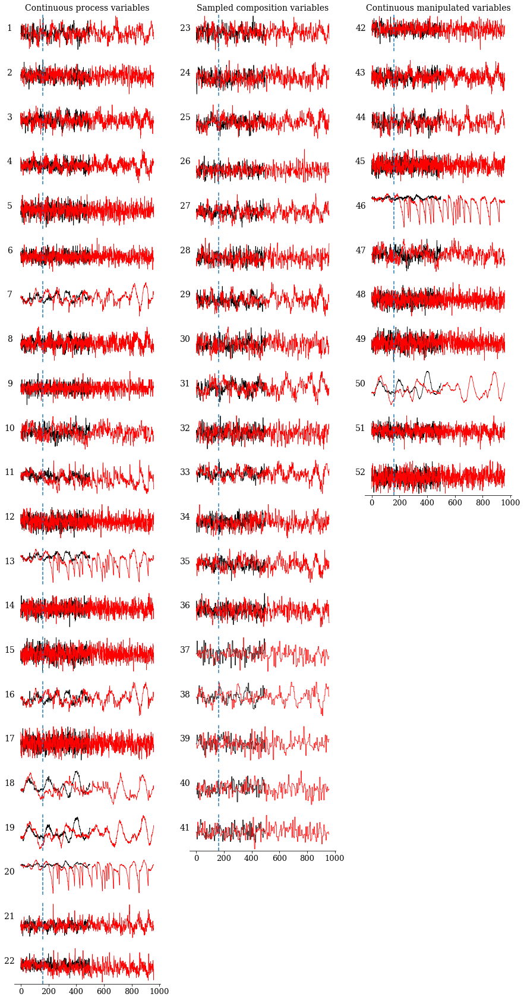

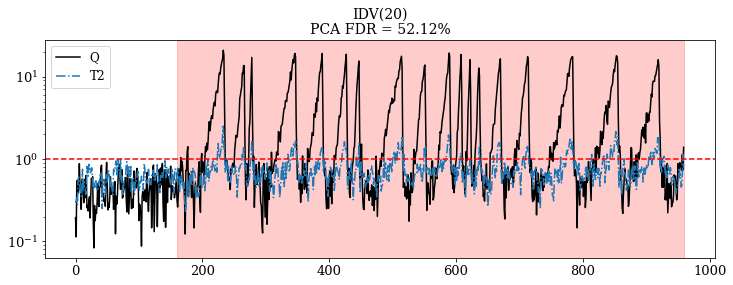

In [55]:
plot_tep_fault(20)

### Faults summary

The following table shows a summary of the fault characteristics:

In [56]:
summary_faults_tep = pd.DataFrame(index=range(1,21))
summary_faults_tep['Type'] = 7*['Step']+5*['Random variation']+['Slow drift']+2*['Sticking']+5*['Unknown']
summary_faults_tep['Location'] = ['Distributed','Distributed','-','Local','Distributed','Distributed','Distributed','Distributed','-','Local','Local','Distributed','Distributed','Local','-','Local','Local','Distributed','Local','Local']
summary_faults_tep['Start'] = ['Abrupt','Abrupt','Abrupt','Abrupt','Abrupt','Abrupt','Abrupt','Abrupt','Abrupt','Abrupt','Abrupt','Abrupt','Incipient','Abrupt','Abrupt','?','?','?','?','?']
summary_faults_tep['End'] = ['New SS','New SS','-','New SS','Same SS','Shutdown','Same SS','Fluctuations','-','Fluctuations','Fluctuations','Fluctuations','Fluctuations','Fluctuations','-','Fluctuations','Fluctuations','Shutdown','Fluctuations','Fluctuations']
summary_faults_tep['PCA FDR (%)'] = fdrs
summary_faults_tep

,Type,Location,Start,End,PCA FDR (%)
1,Step,Distributed,Abrupt,New SS,99.875
2,Step,Distributed,Abrupt,New SS,99.000
3,Step,-,Abrupt,-,2.000
4,Step,Local,Abrupt,New SS,99.875
5,Step,Distributed,Abrupt,Same SS,29.250
6,Step,Distributed,Abrupt,Shutdown,100.000
7,Step,Distributed,Abrupt,Same SS,100.000
8,Random variation,Distributed,Abrupt,Fluctuations,98.250
9,Random variation,-,Abrupt,-,2.125
10,Random variation,Local,Abrupt,Fluctuations,18.625


Obs:

* When the effects of the fault are local, the steady-state (SS) that appears in the column 'End Dev' is referring to the variables where the fault is felt.
* In fault `IDV(7)`, although the whole process returns to the original steady-state, the variable `XMV(4)` stabilizes at a higher level, leading to a high FDR.
* Random variation faults, even if abrupt, can lead to a slow distribution of effects in the plant.
* Some of the unknown faults provide visual clues about their initial development, such as the incipient behaviors in `IDV(17)` and `IDV(18)`, but we cannot know for sure.

## Notable works

This is a list of notable works on the Tennessee Eastman Process.

* [Dows and Vogel (1993) - A plant-wide industrial process control problem](https://doi.org/10.1016/0098-1354(93)80018-I)
    * Original paper presenting the simulation in Fortran code.
* [Lyman and Georgakis (1995) - Plant-wide control of the Tennessee Eastman problem](https://www.sciencedirect.com/science/article/abs/pii/009813549400057U)
    * SISO control structures for TEP, used to generate the data analyzed in this Jupyter notebook.
* [Ricker (1996) - Decentralized control of the Tennessee Eastman challenge process](https://www.sciencedirect.com/science/article/pii/0959152496000315)
    * Another widely used control structure for TEP.
* [Chiang et al. (2001) - Fault Detection and Diagnosis in Industrial Systems](https://link.springer.com/book/10.1007/978-1-4471-0347-9)
    * Book with chapters containing detailed descriptions and applications of TEP.
* [Yin et al. (2012) - A comparison study of basic data-driven fault diagnosis and process monitoring methods on the benchmark Tennessee Eastman process](https://linkinghub.elsevier.com/retrieve/pii/S0959152412001503)
    * Performance comparison of PCA, DPCA, FDA, PLS, TPLS, MPLS, ICA/MICA and SAP techniques applied to TEP.
* [Bathelt et al. (2015) - Revision of the Tennessee Eastman Process Model](https://doi.org/10.1016/j.ifacol.2015.08.199)
    * TEP code revised and extended for use in the MATLAB environment.
* [Rieth et al. (2017) - Issues and Advances in Anomaly Detection Evaluation for Joint Human-Automated Systems](https://doi.org/10.1007/978-3-319-60384-1_6)
    * Work that motivated the generation of the extended dataset analyzed in this Jupyter notebook.
* [Reinartz et al. (2021) - An Extended Tennessee Eastman Simulation Dataset for Fault Detection and Decision Support Systems](https://www.sciencedirect.com/science/article/pii/S0098135421000594)
    * New TEP dataset extended with mode transitions and fault magnitudes.
    